# In this Jupyter notebook we will show the image processing pipeline used to quantify adhesion.

In [1]:
#importing the packages used
import numpy as np
import matplotlib.pyplot as plt
import statistics as st
import scipy.stats as stats
import pandas as pd
from skimage.morphology import square
from skimage.measure import label, regionprops
from matplotlib.collections import PatchCollection
import matplotlib.patches as mpatches
from matplotlib.axes import Axes
from skimage.filters import threshold_otsu
import skimage.io
import skimage.filters
import skimage.measure
import seaborn as sns
import re
import os
import sys
import yeastmlp.adhesion as adh
root = '/Users/k23030440/S.-Pombe-MLPs - most recent/'

plt.rcParams["font.family"] = "Arial"



# Import strain layouts

In [2]:
#Get the layout of the strains, make a vector of strain names in order (by row so A1, A2, etc.)

old_wild_isolate_map = root + "internal data/Old wild strain map.xlsx"
new_wild_isolate_map = root + "internal data/final wild strain map.xlsx"
segregant_map = root + "internal data/segregant_strains_map.xlsx"
mimi_cris_map = root + "internal data/strains_mimi_cris.xlsx"


    


# Assembling dataframes

### Wild isolates on EMM

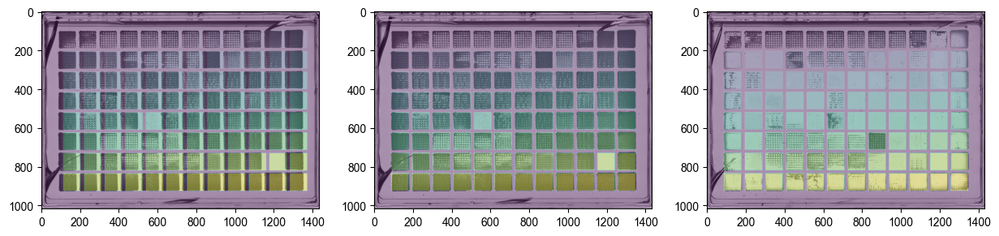

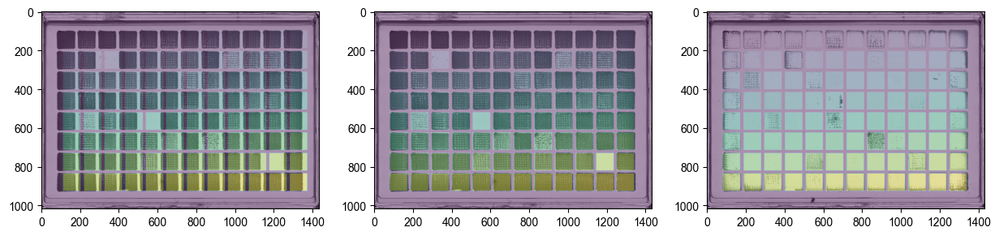

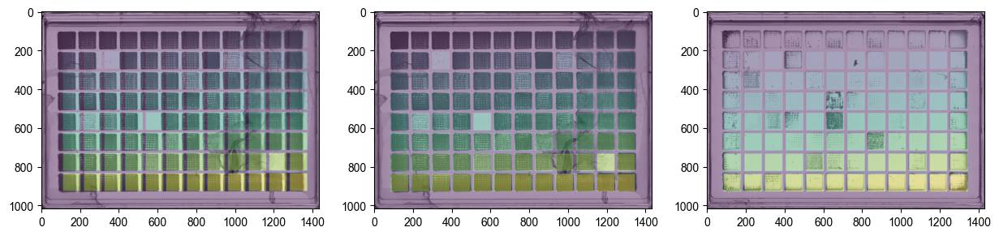

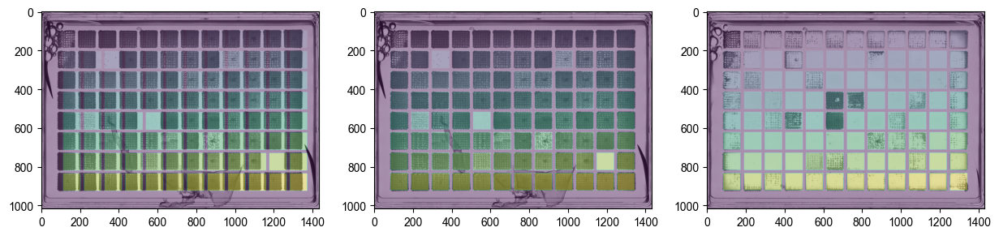

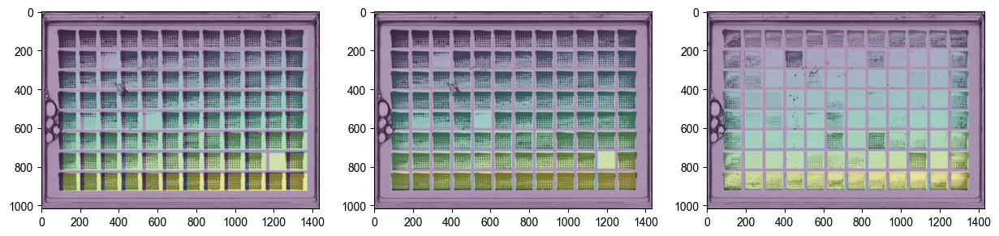

...

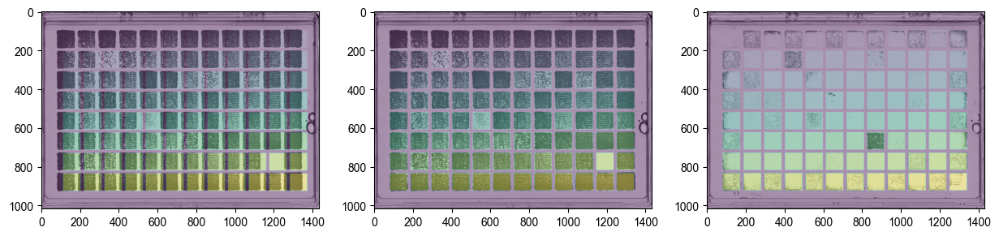

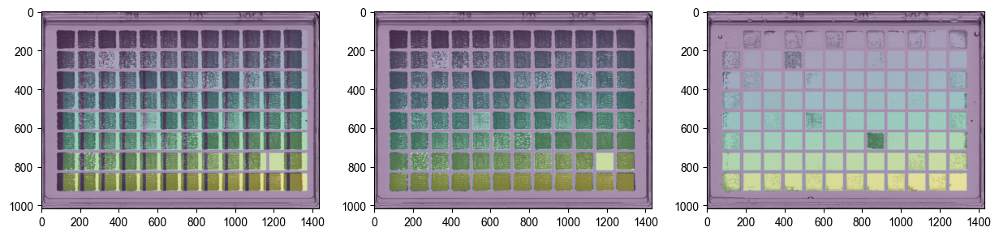

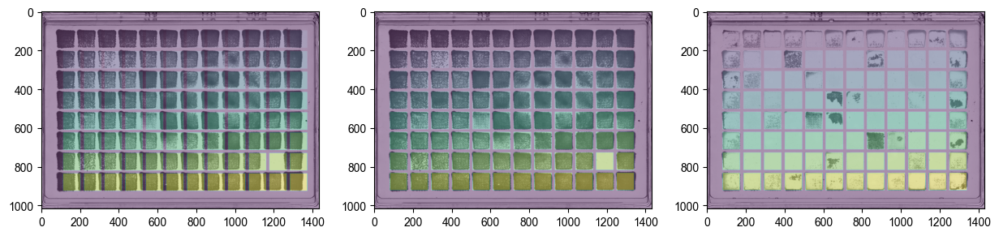

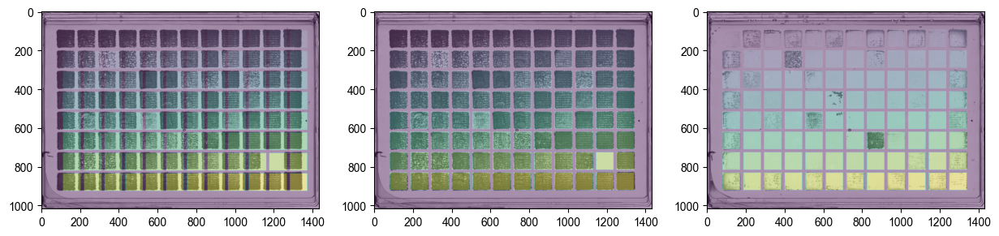

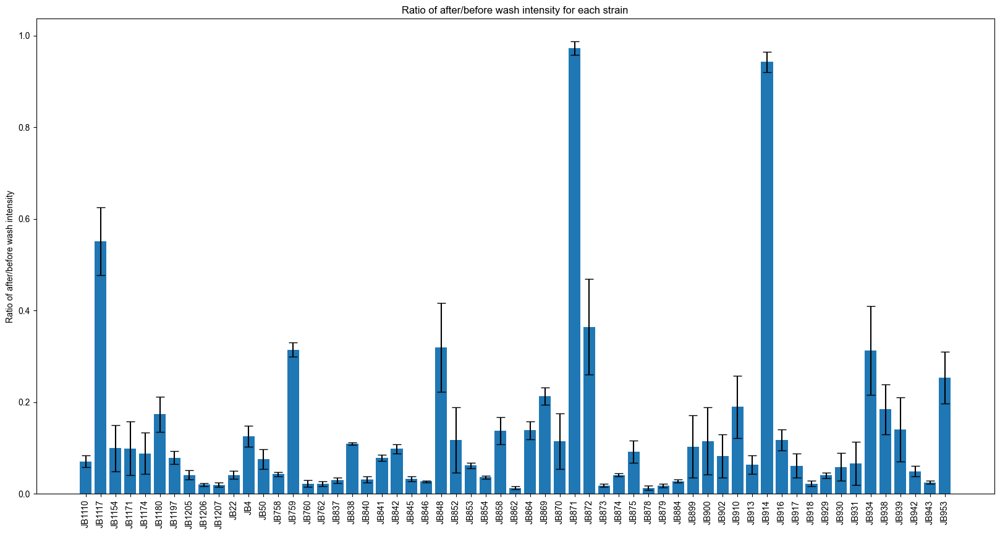

,strain,ratio,before_wash,after_wash,sem,filtered_all_ratio_vals,n
0,JB1110,0.070539,0.180259,0.011723,0.012829,"[0.04840254331014328, 0.050932153527501065, 0....",6
1,JB1117,0.550944,0.417155,0.218027,0.073867,"[0.8235594165542443, 0.2393587998651804, 0.227...",10
2,JB1154,0.099399,0.382942,0.033994,0.050749,"[0.5552307072019596, 0.03438858803310515, 0.04...",10
3,JB1171,0.098766,0.378770,0.031195,0.058712,"[0.626116642555209, 0.03494921771275881, 0.049...",10
4,JB1174,0.088359,0.400439,0.030724,0.045043,"[0.485830656090683, 0.031195400825644086, 0.11...",10


In [3]:

image_for_raw_layout = root + "internal data/filled_out_plate.jpg"
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM_after"
wild_isolate_emm =  adh.result_from_folders_of_ims(folder1,folder2, new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_emm)
wild_isolate_emm.to_csv(root + "Bence folder/Image processing - Adhesion assay/wild_isolate_emm.csv")
wild_isolate_emm.head()

### Wild isolates on YES

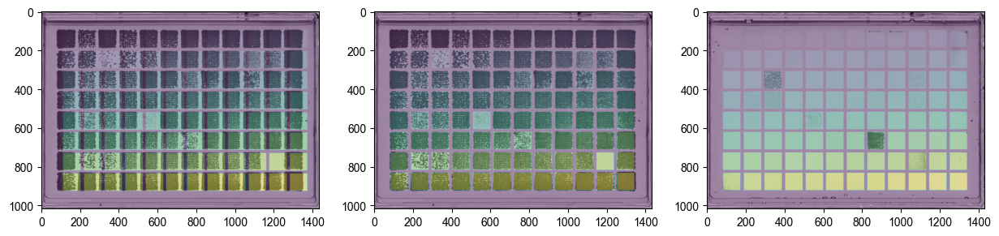

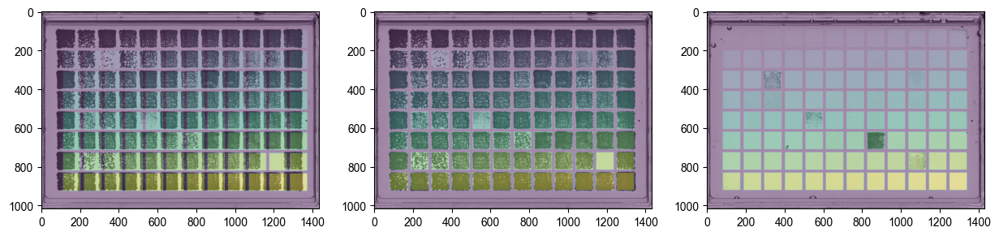

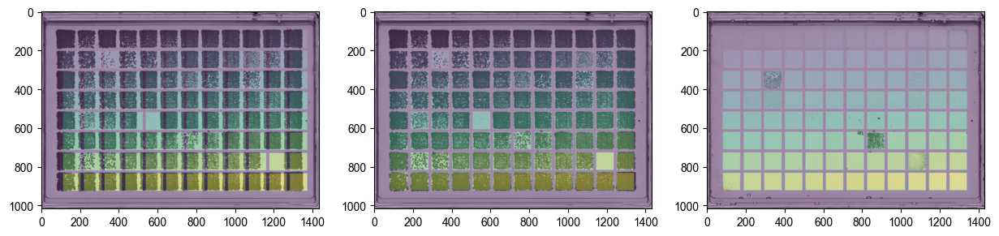

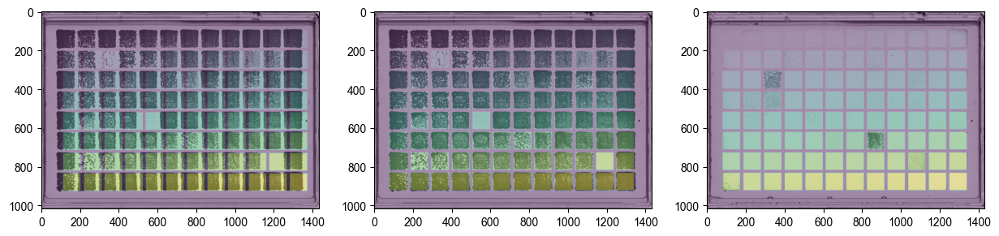

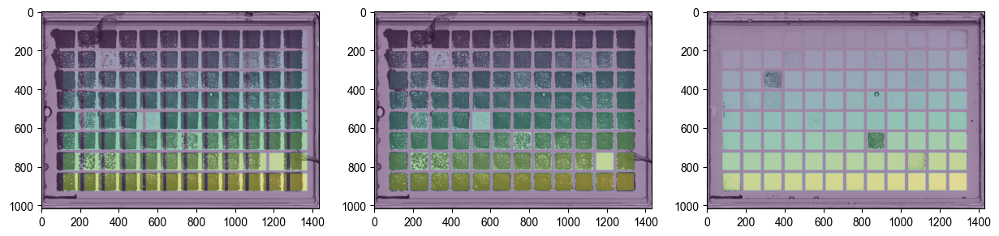

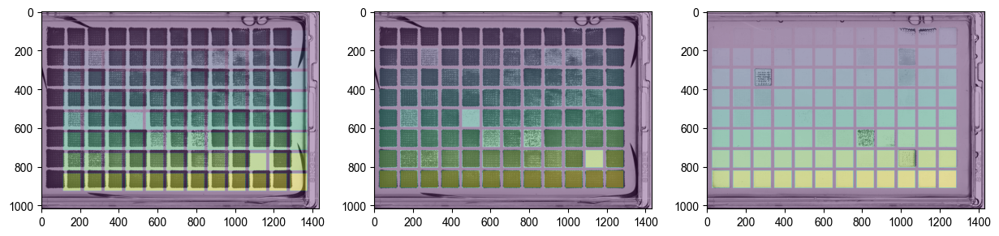

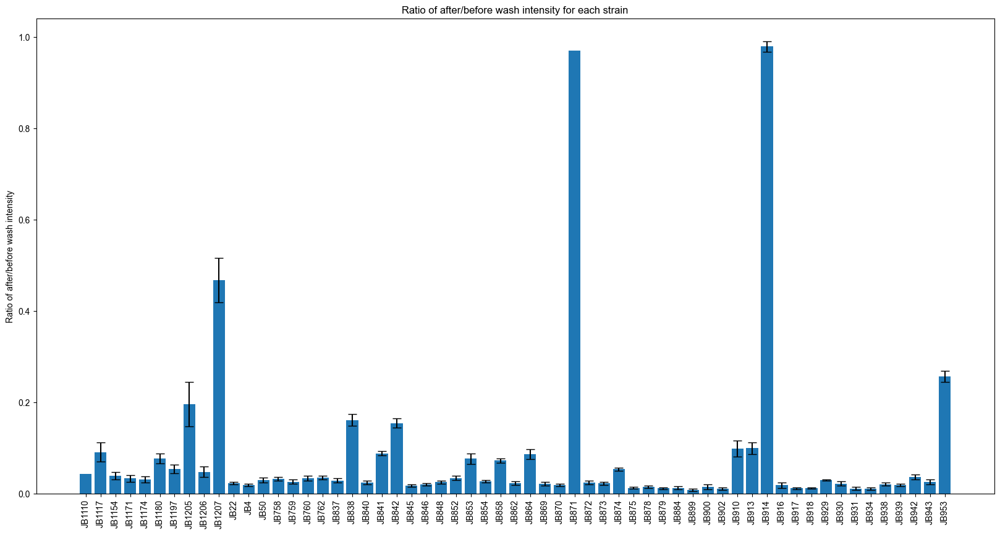

,strain,ratio,before_wash,after_wash,sem,filtered_all_ratio_vals,n
0,JB1110,0.043159,0.188227,0.008124,NaN,[0.04315944513805384],1
1,JB1117,0.091304,0.368211,0.032215,0.020385,"[0.11079780227485579, 0.07682094327313733, 0.0...",6
2,JB1154,0.039851,0.398957,0.015173,0.008153,"[0.06453754219181082, 0.050181417104594735, 0....",6
3,JB1171,0.033741,0.414164,0.013994,0.007256,"[0.056510959770567505, 0.03643082589245232, 0....",6
4,JB1174,0.031650,0.442030,0.014120,0.006802,"[0.05293627824912213, 0.03742922651734276, 0.0...",6


In [4]:

image_for_raw_layout = root + "internal data/filled_out_plate.jpg"

folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES_after"
wild_isolate_yes =  adh.result_from_folders_of_ims(folder1,folder2, new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_yes)
wild_isolate_yes.to_csv(root + "Bence folder/Image processing - Adhesion assay/wild_isolate_yes.csv")
wild_isolate_yes.head()

# Wild isolates from Cris and Mimi on EMM - to see whether strains were scrambled



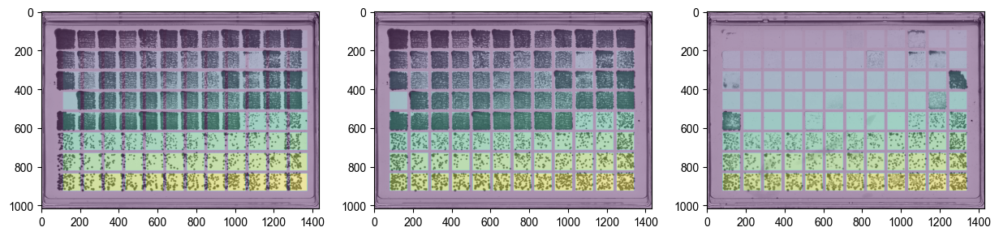

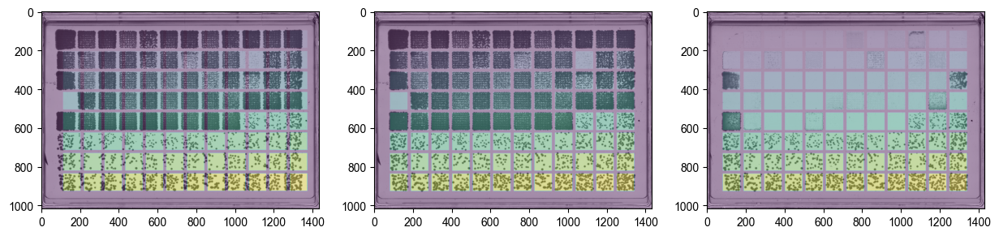

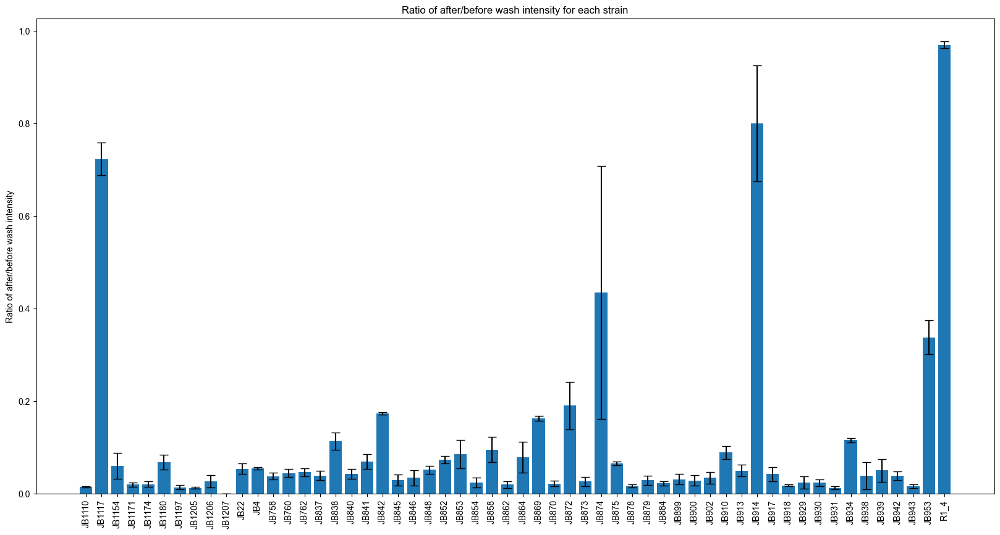

In [5]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates (MIMI)_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates (MIMI)_EMM_after"
wild_isolate_mimi_emm =  adh.result_from_folders_of_ims(folder1,folder2, mimi_cris_map, image_for_raw_layout,keep_all=True)
adh.barchart_from_res(wild_isolate_mimi_emm)



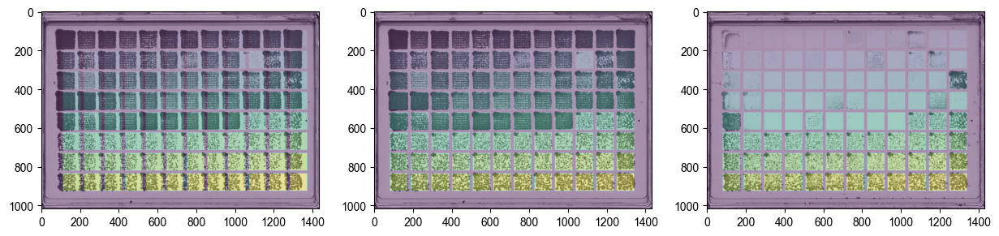

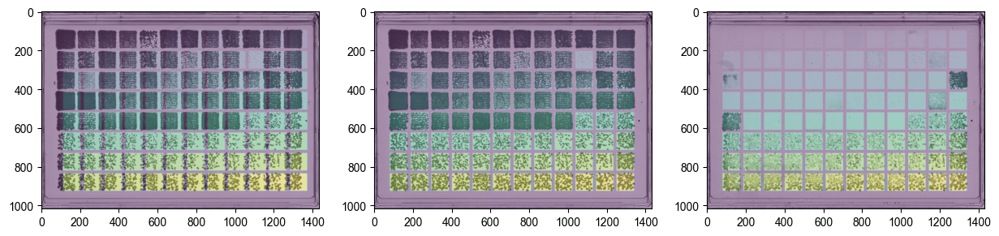

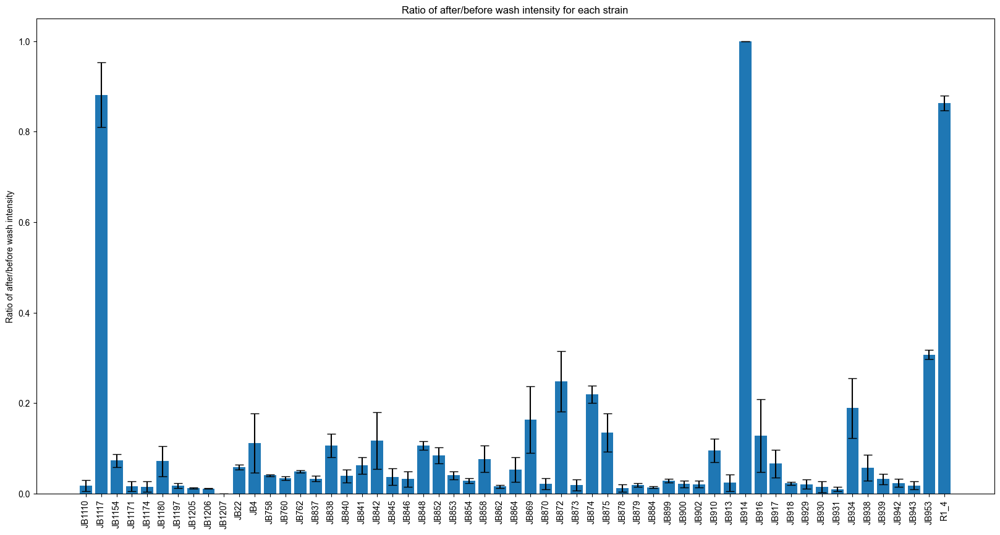

In [6]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates (CRIS)_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates (CRIS)_EMM_after"
wild_isolate_cris_emm =  adh.result_from_folders_of_ims(folder1,folder2, mimi_cris_map, image_for_raw_layout,keep_all=True)
adh.barchart_from_res(wild_isolate_cris_emm)




## Wild isolates on Caf

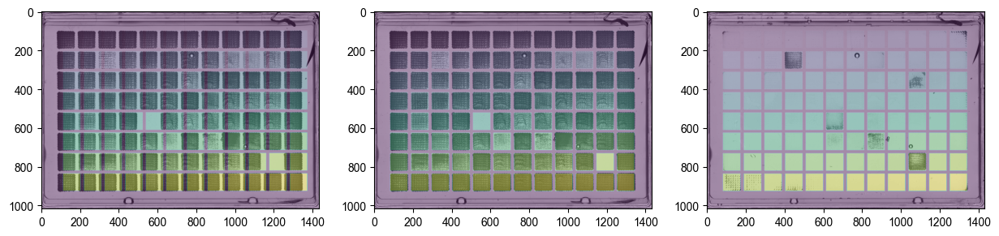

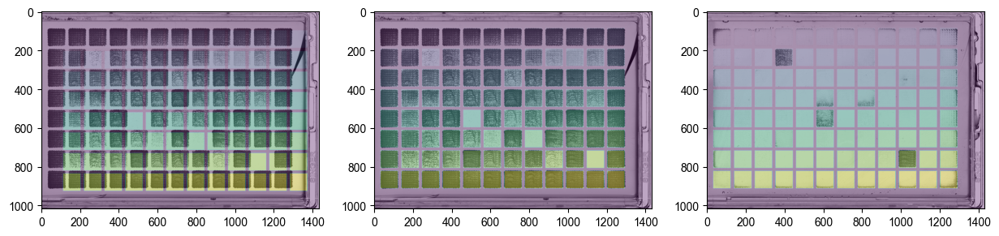

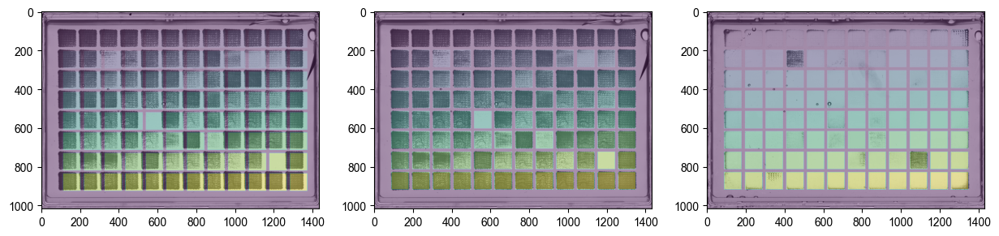

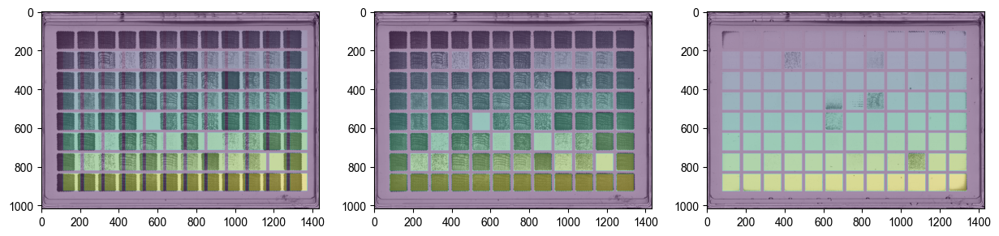

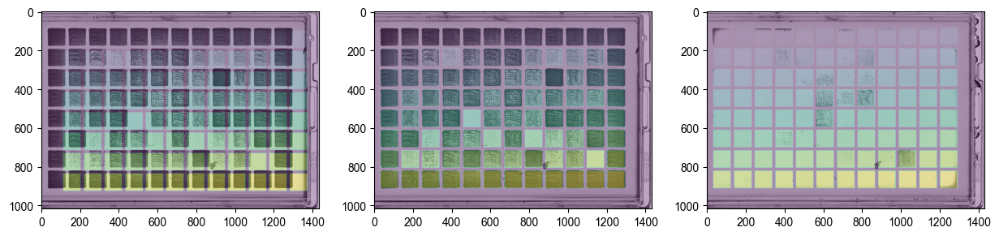

...

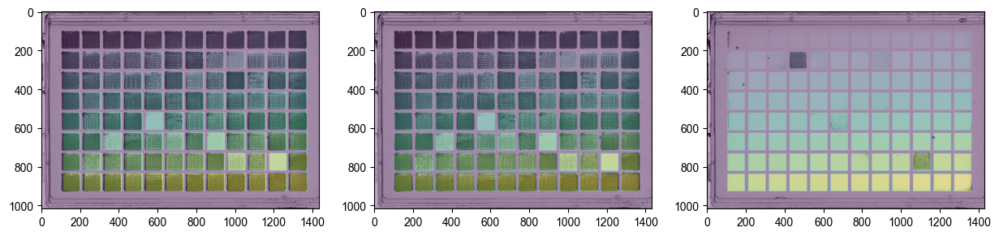

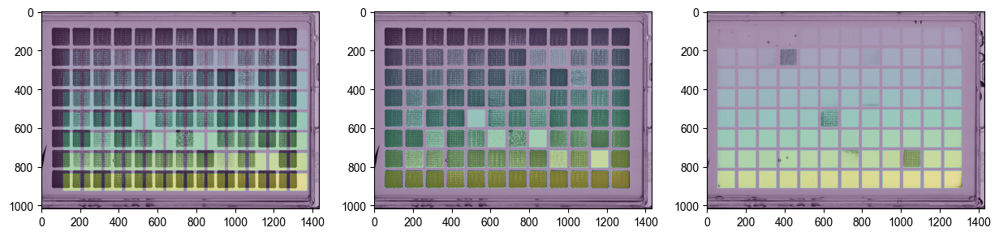

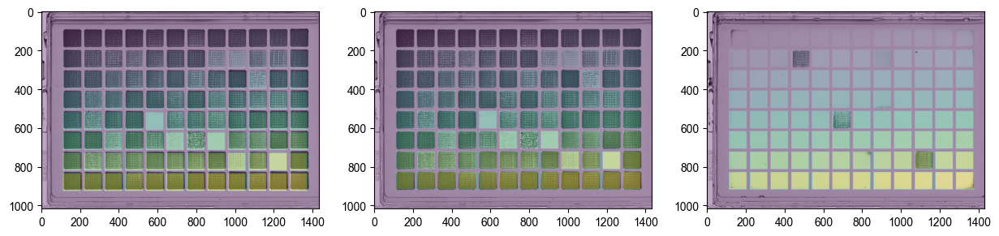

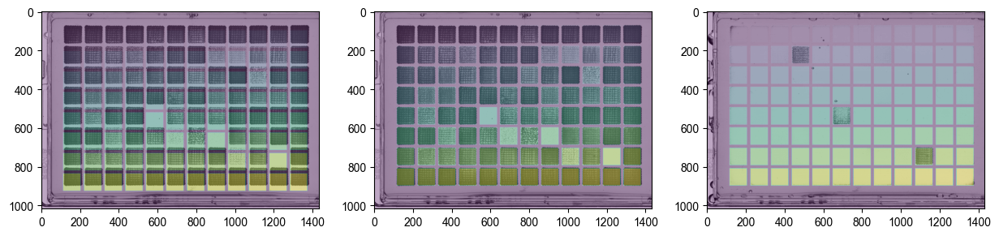

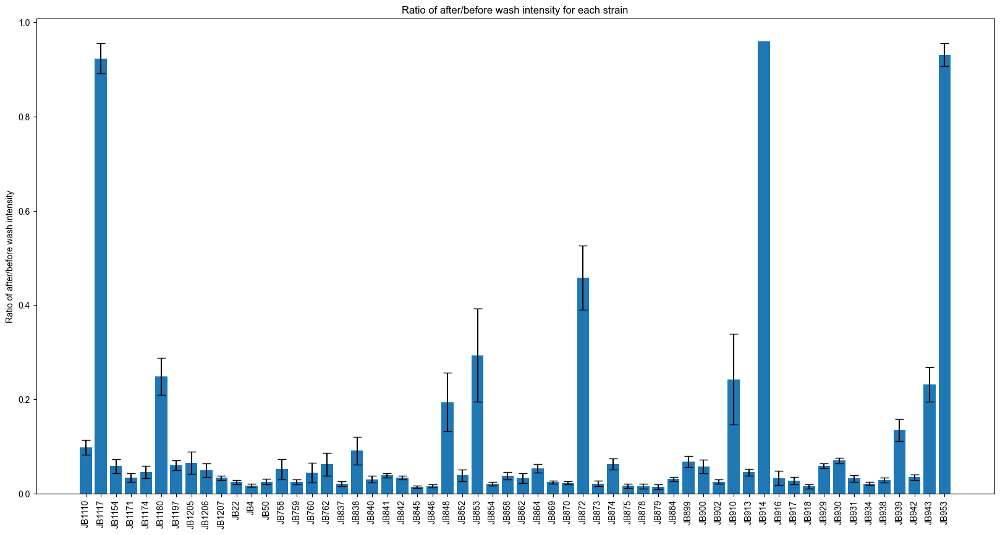

In [7]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine_after"
wild_isolate_yes_caf =  adh.result_from_folders_of_ims(folder1,folder2, new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_yes_caf)


# Wild isolates on Rap 

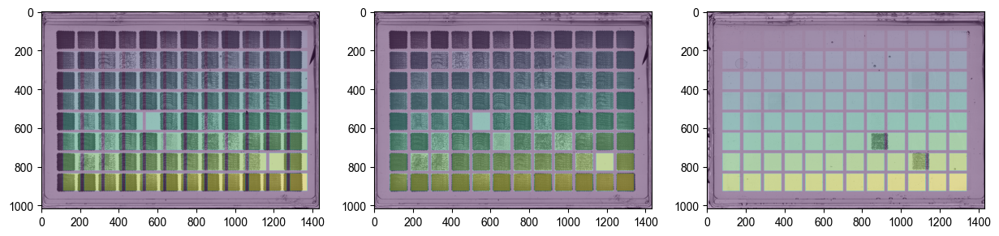

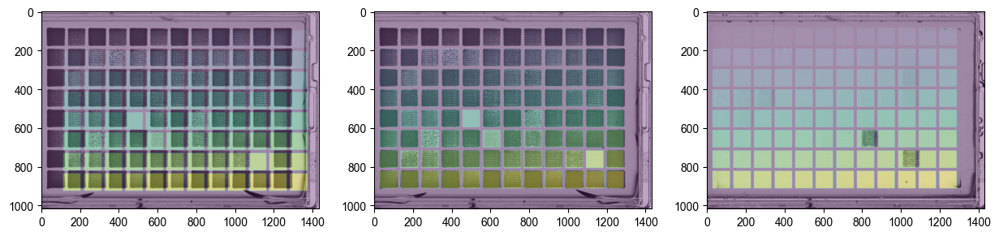

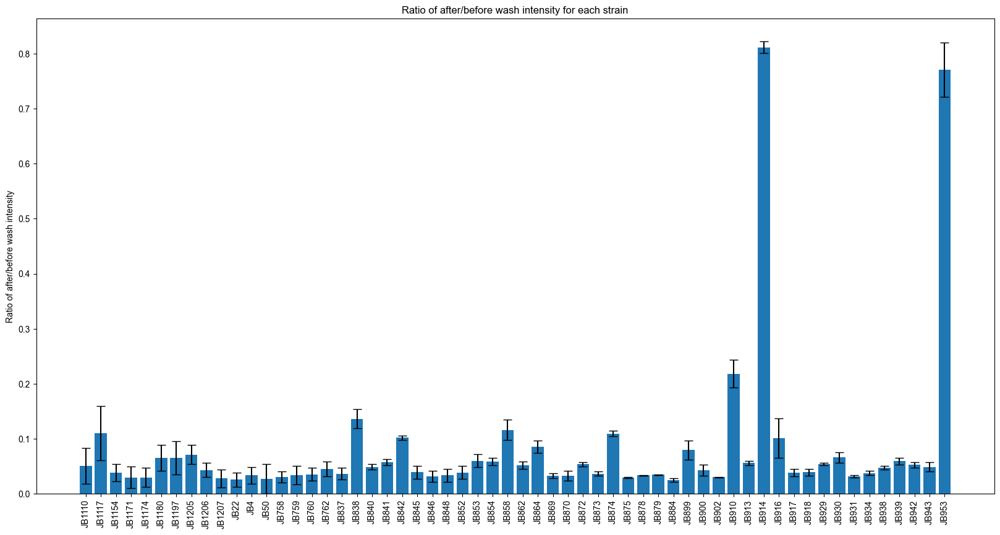

In [8]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Rapamycin_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Rapamycin_after"
wild_isolate_yes_rap =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_yes_rap)


# Wild isolates on caffeine and rapamycin




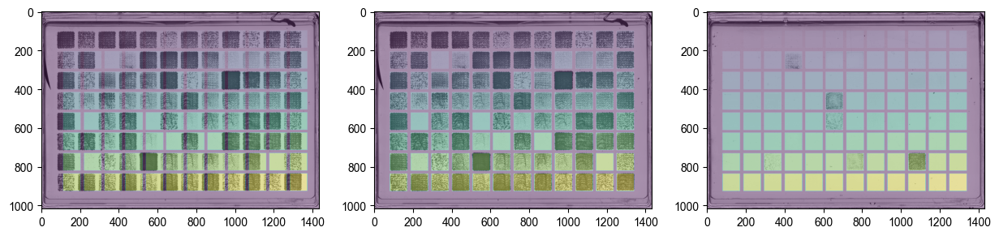

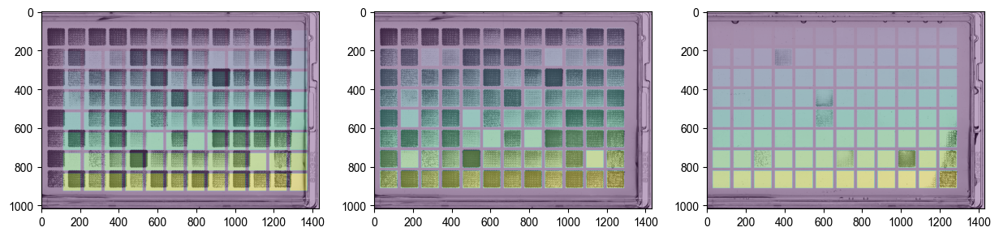

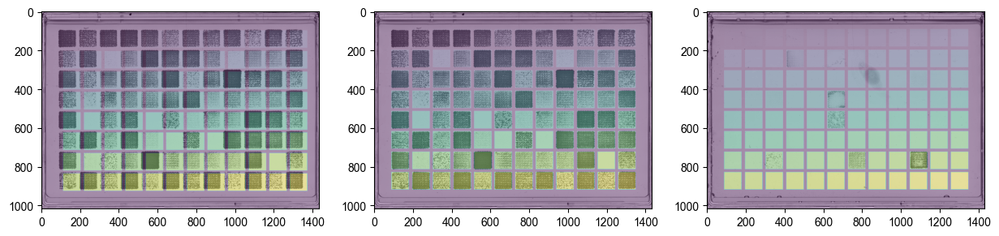

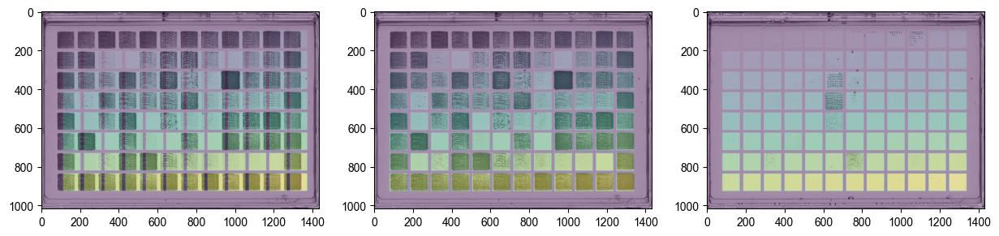

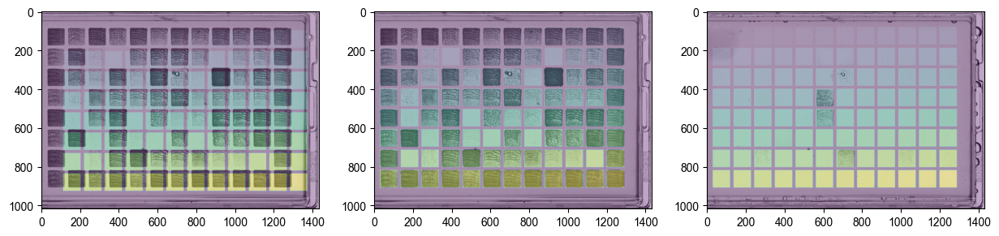

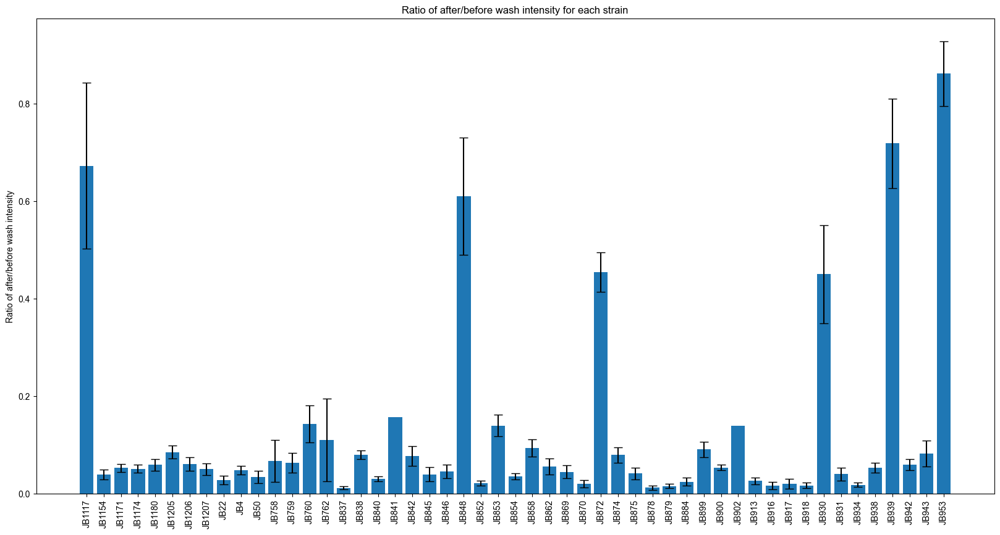

In [9]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine + Rapamycin_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine + Rapamycin_after"
wild_isolate_yes_caf_rap =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_yes_caf_rap)

# Wild isolates EMM hydrogen peroxide


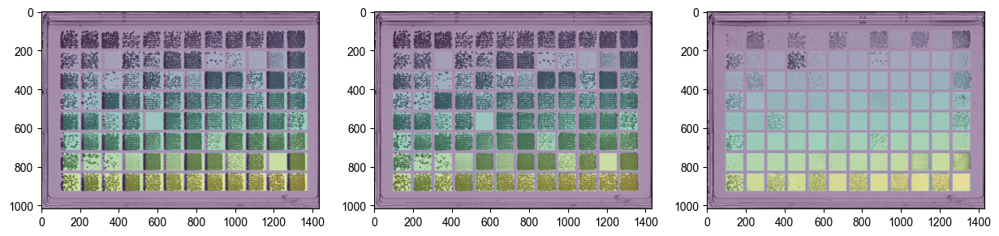

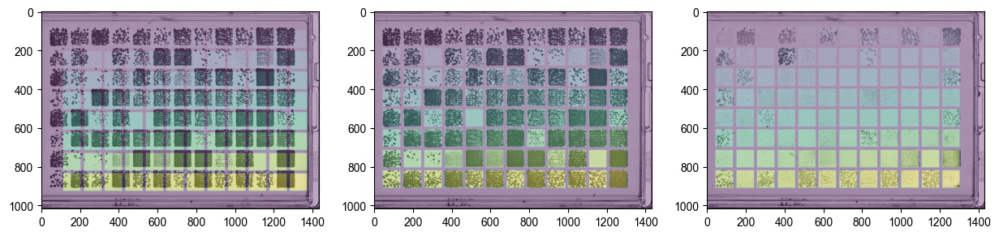

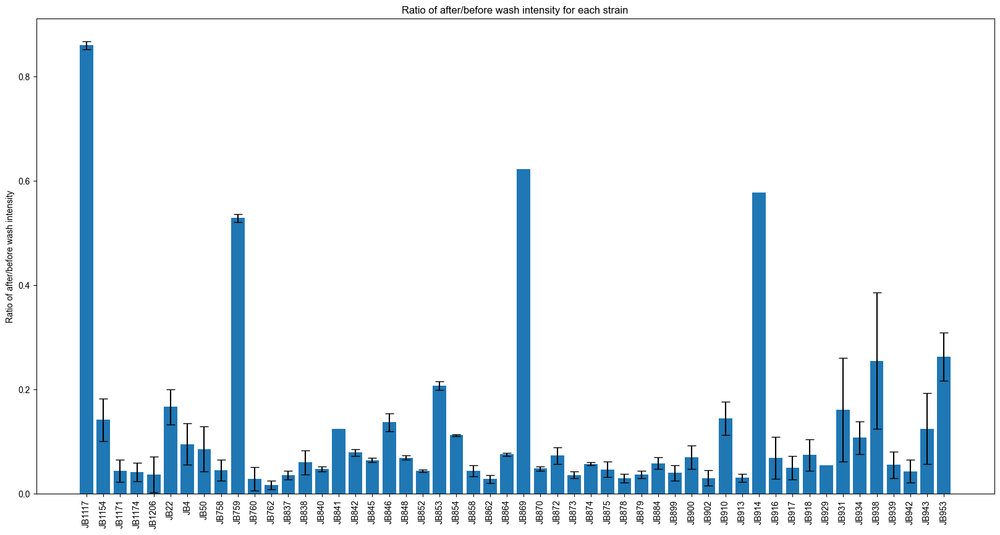

In [10]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM + H2O2_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM + H2O2_after"
wild_isolate_emm_H2O2 =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_emm_H2O2)

# Wild isolates YES hydrogen peroxide


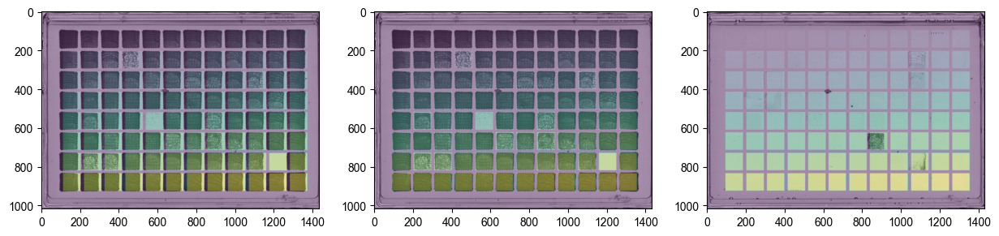

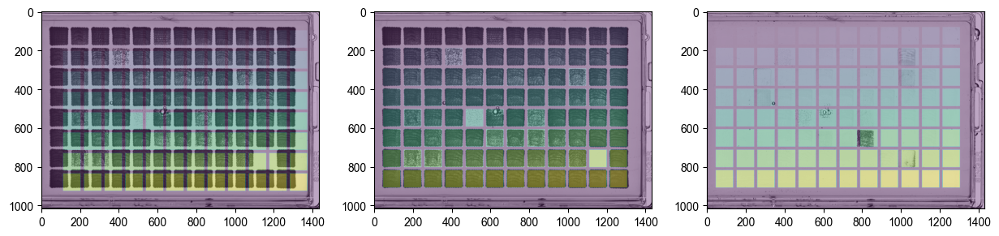

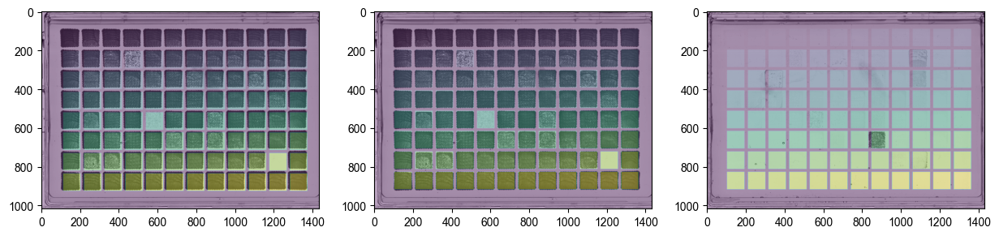

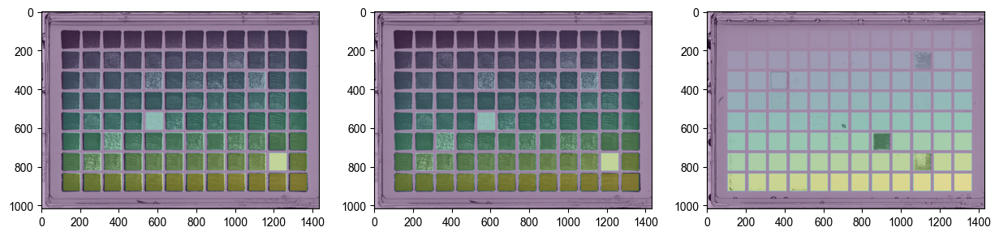

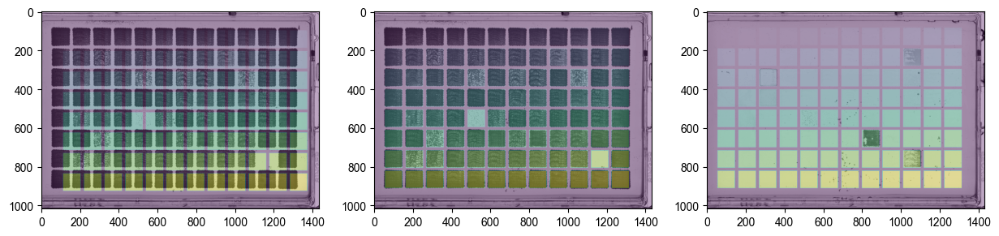

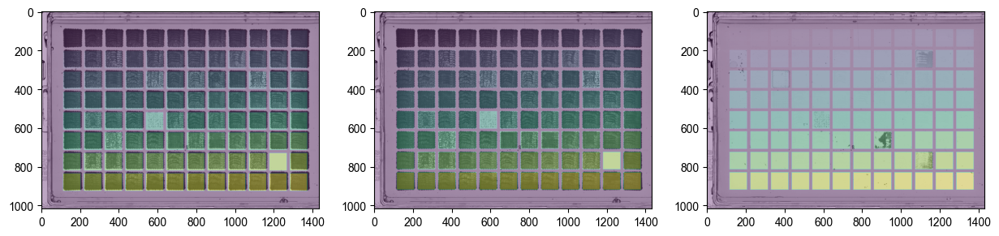

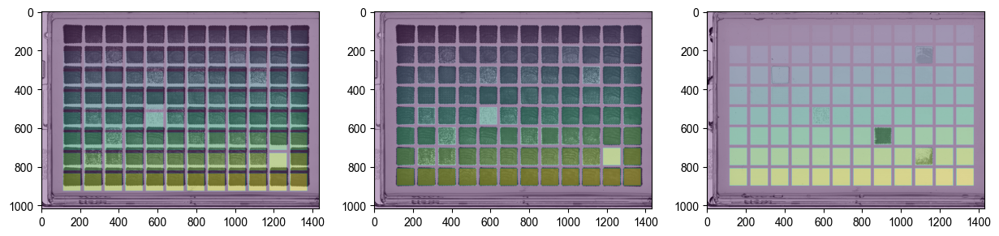

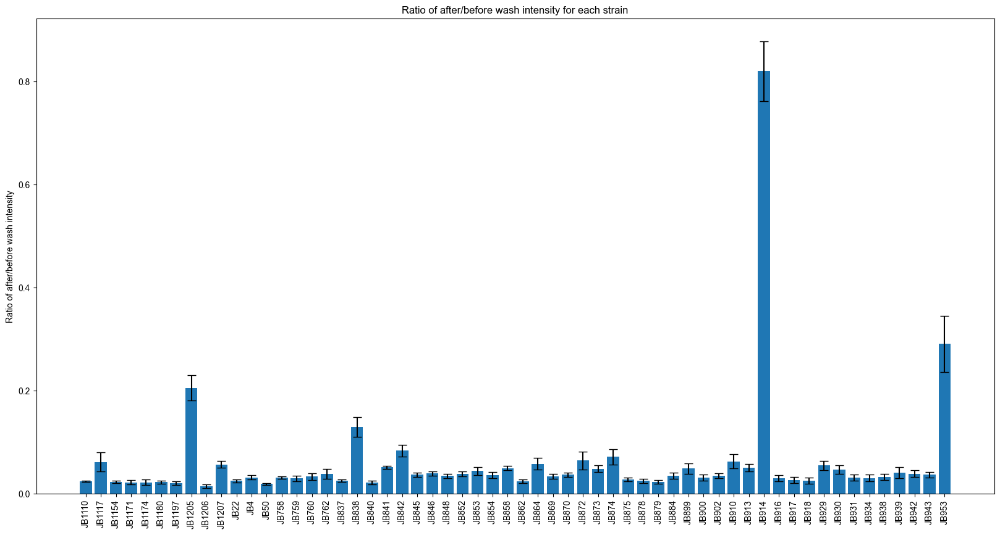

In [11]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + H2O2_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + H2O2_after"
wild_isolate_yes_H2O2 =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_yes_H2O2)

# N starvation in Wild isolates

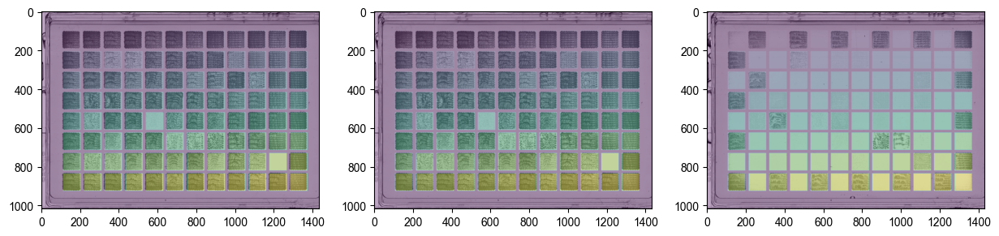

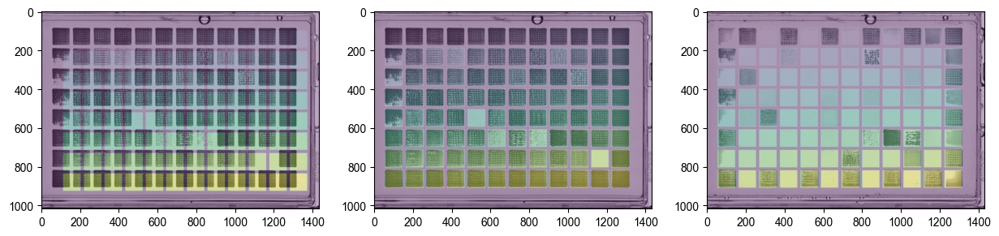

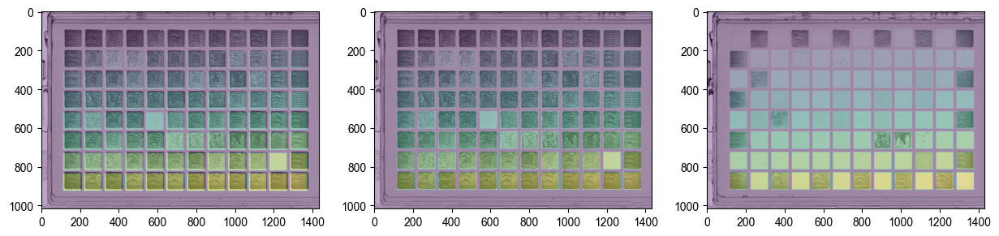

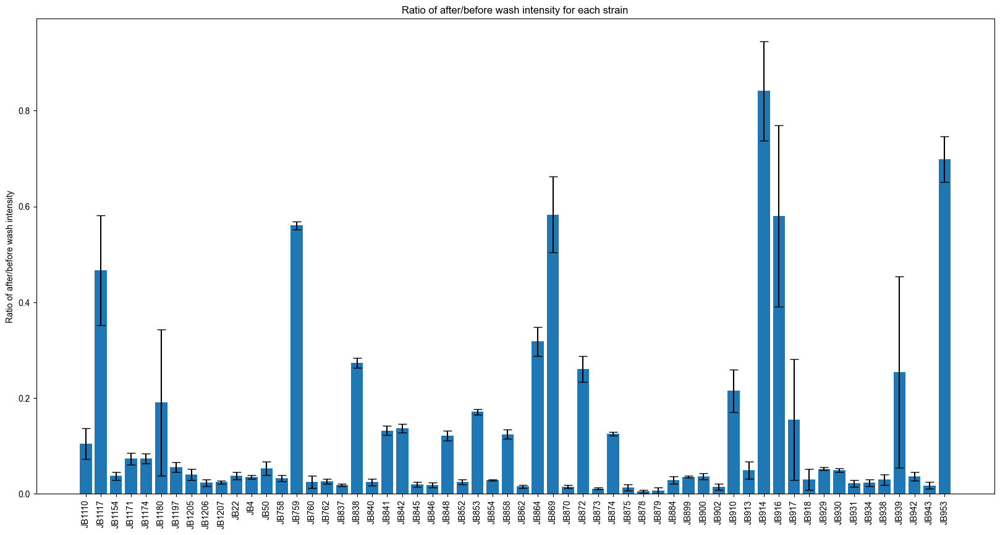

In [12]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Nitrogen_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Nitrogen_after"
wild_isolate_emm_n =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_emm_n)

# P starvation in Wild Isolates

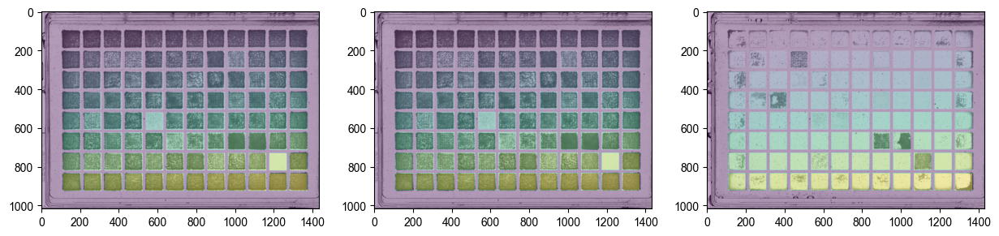

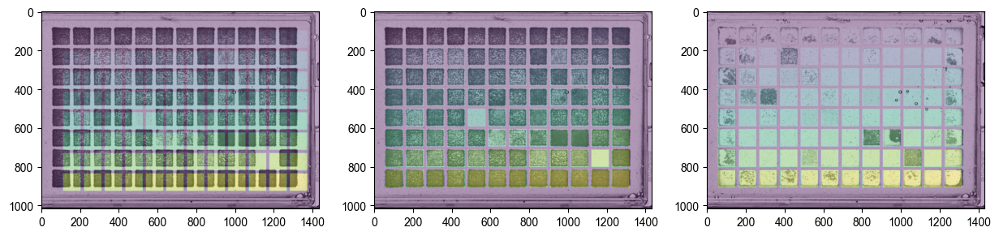

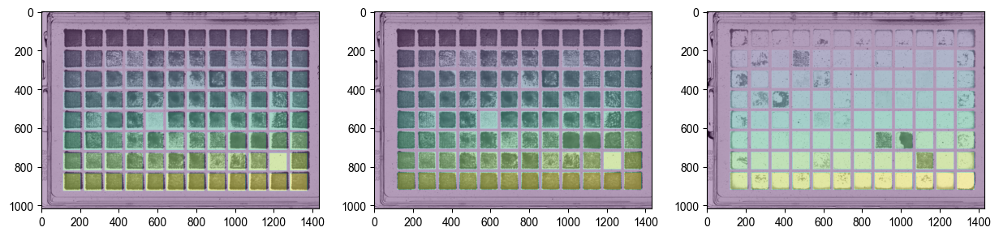

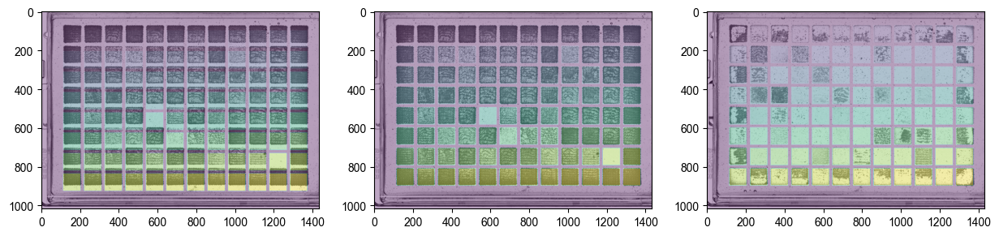

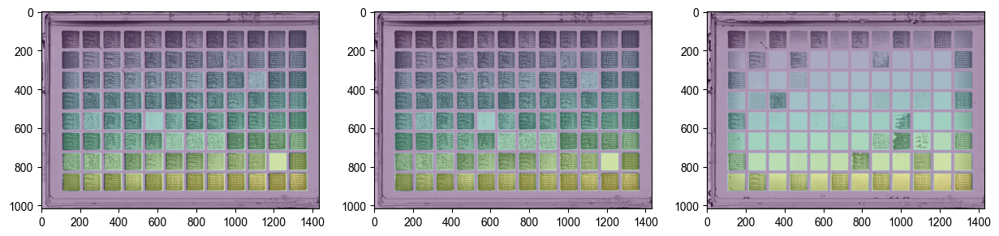

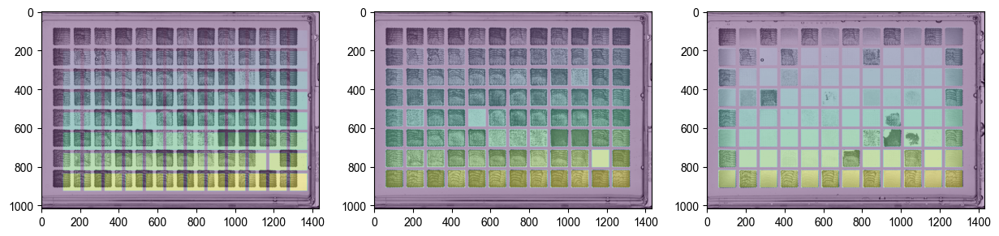

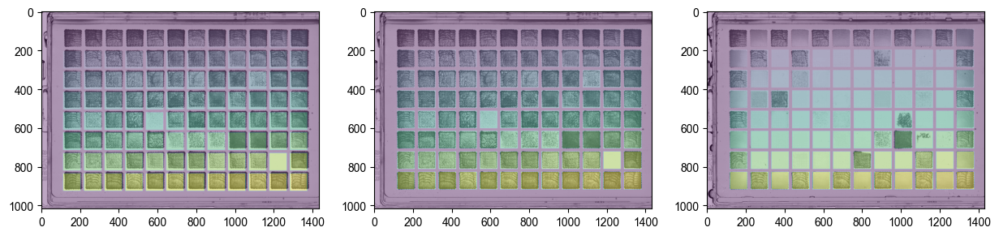

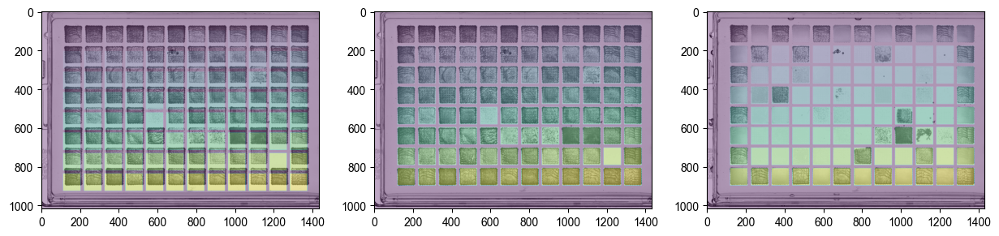

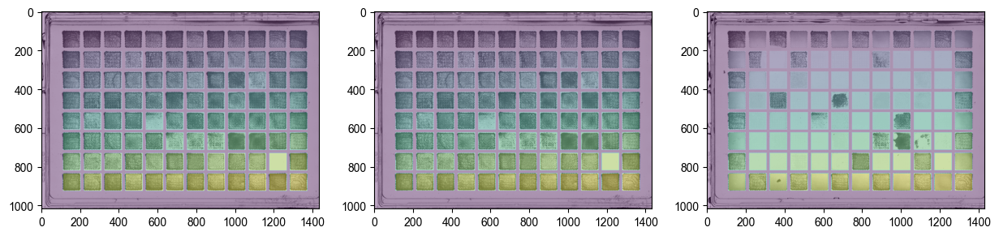

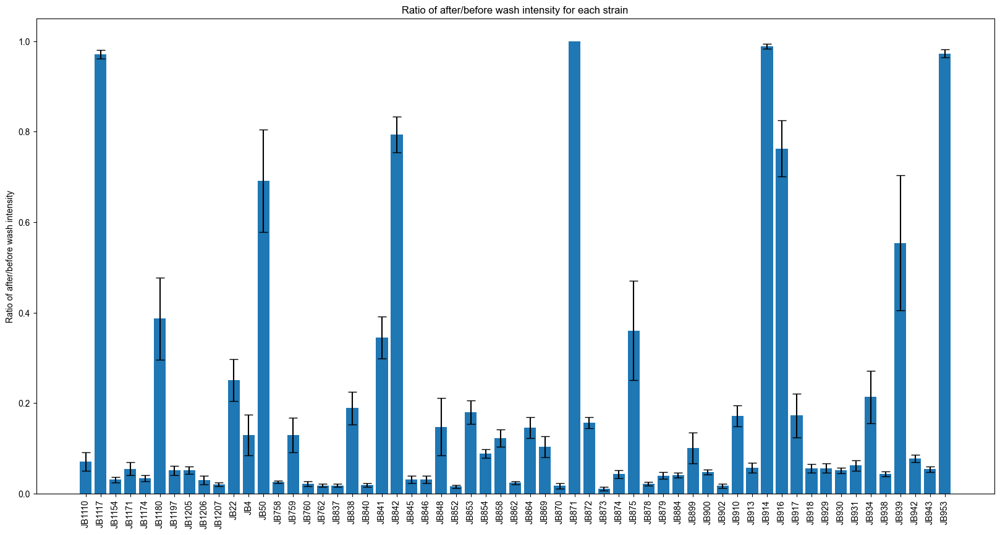

In [13]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Phosphate_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Phosphate_after"
wild_isolate_emm_p =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout,keep_all=False)
adh.barchart_from_res(wild_isolate_emm_p)

### Segregants on EMM

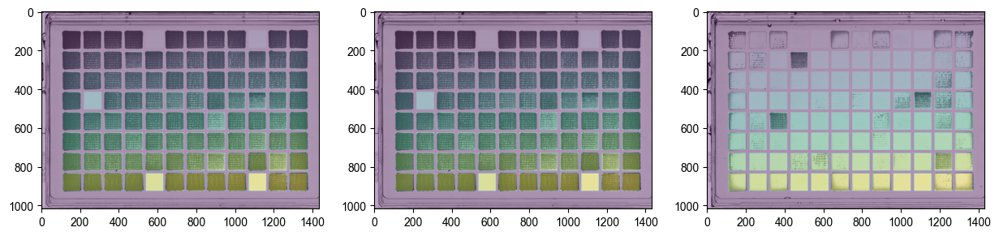

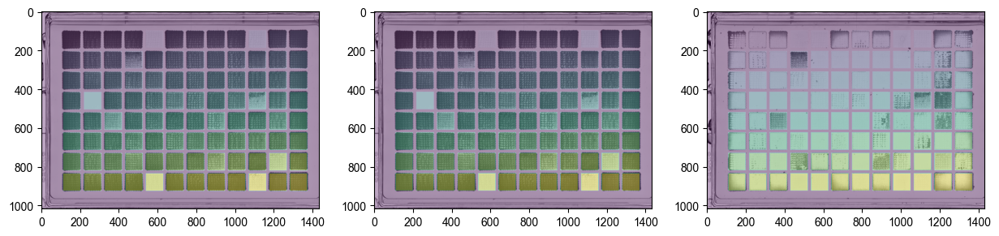

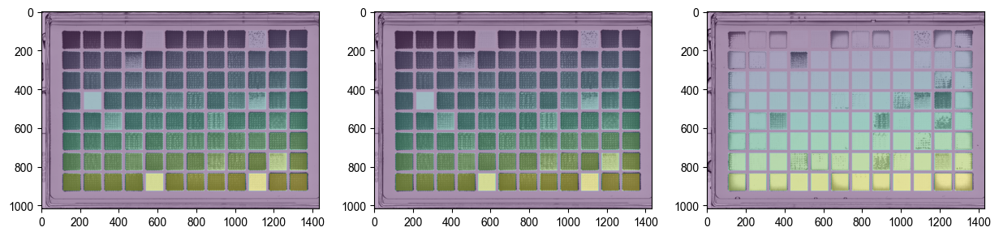

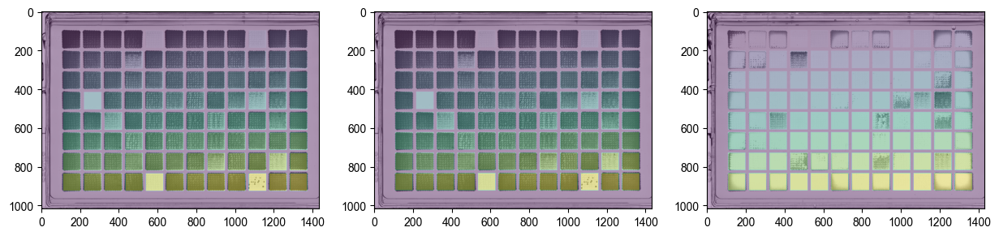

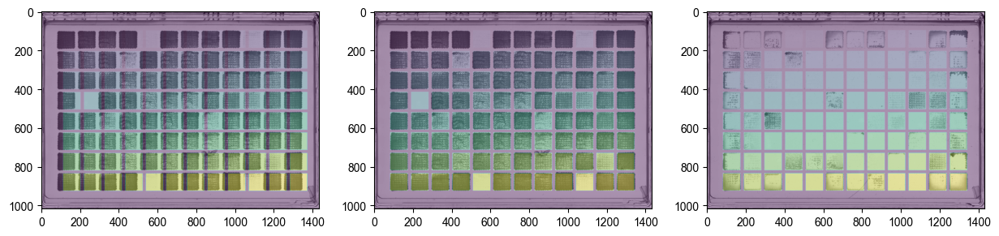

...

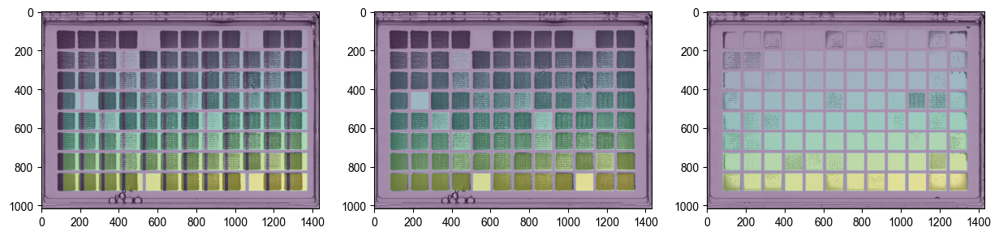

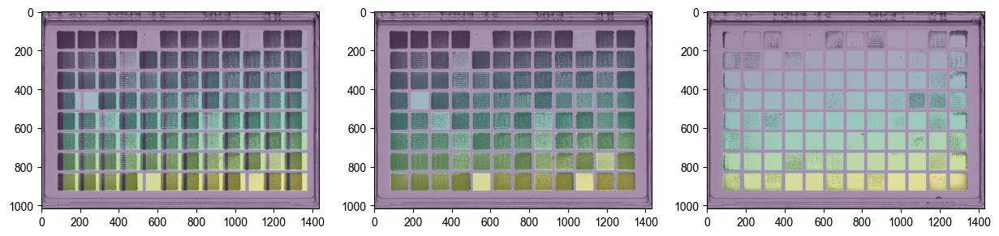

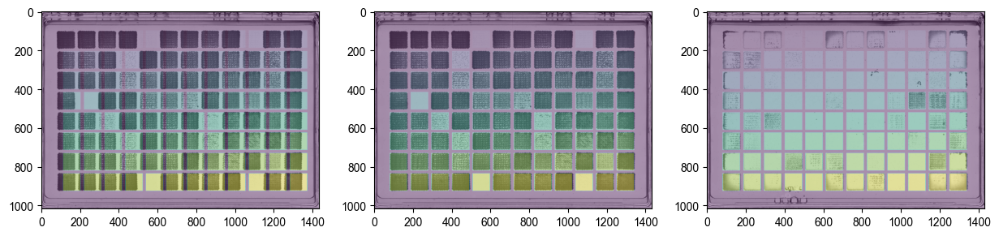

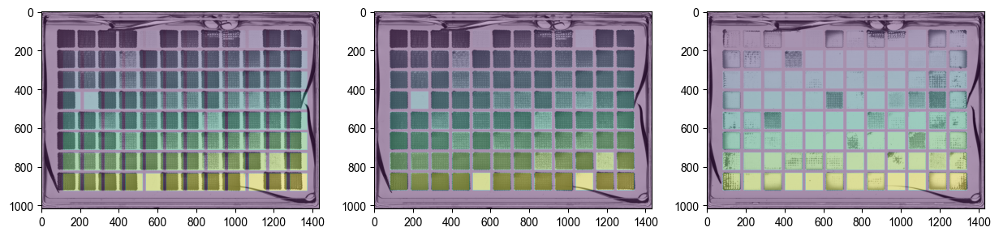

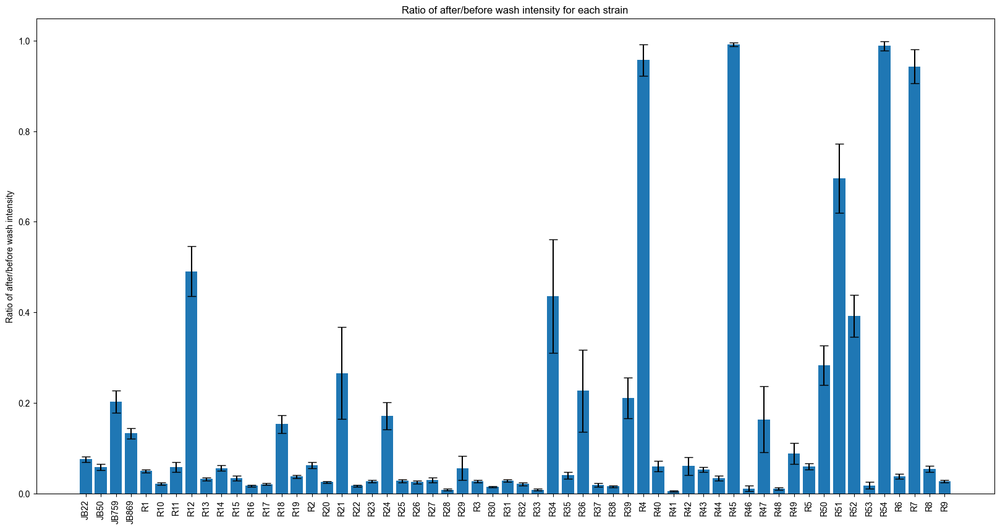

In [14]:
folder1 = root + "internal data/imaging_adhesion/Segregants_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Segregants_EMM_after"
segregant_emm =  adh.result_from_folders_of_ims(folder1,folder2,  segregant_map , image_for_raw_layout,keep_all=False)
segregant_emm.to_csv(root + "Bence folder/Image processing - Adhesion assay/segregants_emm.csv")
adh.barchart_from_res(segregant_emm)

### Segregants on YES


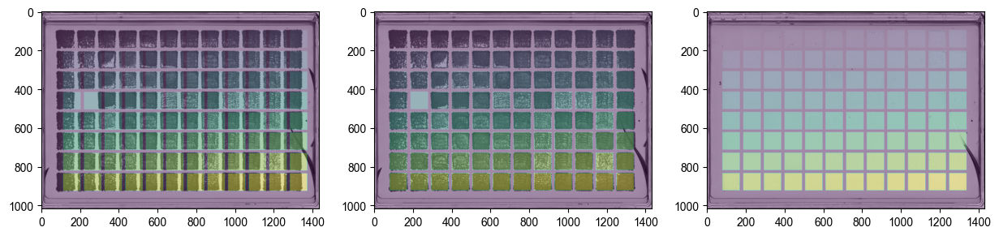

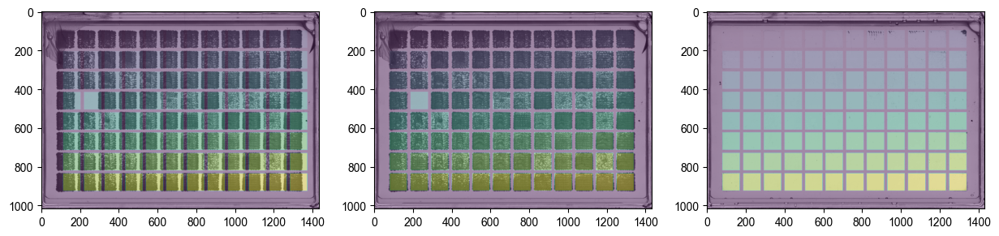

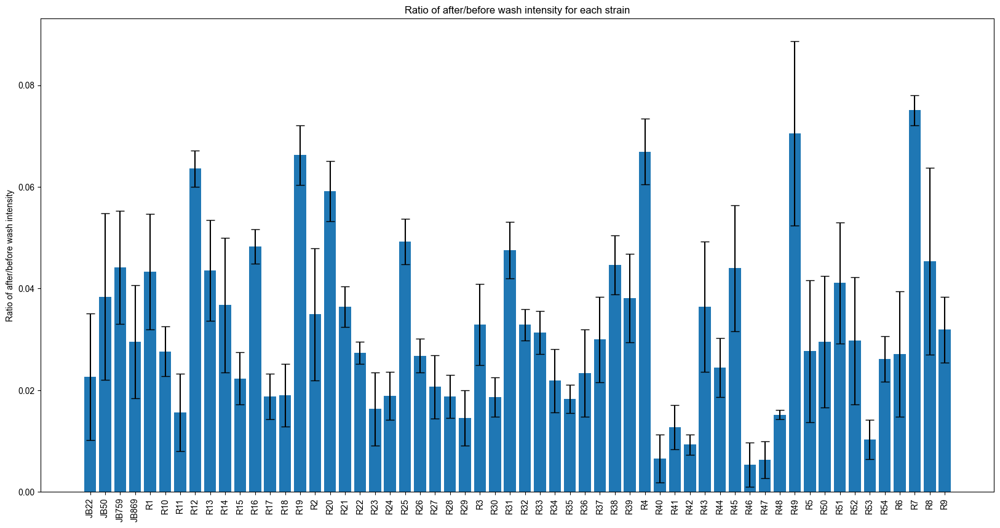

In [15]:
folder1 = root + "internal data/imaging_adhesion/Segregants_YES_before"
folder2 = root + "internal data/imaging_adhesion/Segregants_YES_after"
segregant_yes =  adh.result_from_folders_of_ims(folder1,folder2,  segregant_map , image_for_raw_layout,keep_all=False)
adh.barchart_from_res(segregant_yes)


# Different versions of the WI library

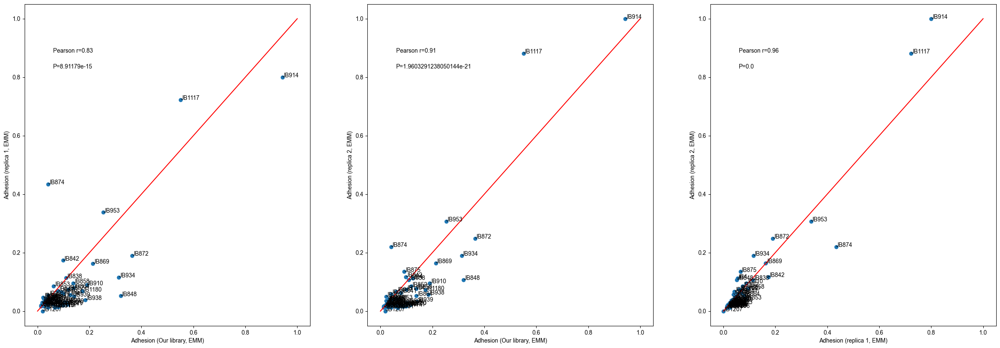

In [16]:
#merge phenotype gwas with mimi and cris and show bars grouped by strain
wi_emm_wi_mimi = pd.merge(wild_isolate_emm,wild_isolate_mimi_emm, on="strain")
wi_emm_wi_mimi_cris = pd.merge(wi_emm_wi_mimi,wild_isolate_cris_emm,on="strain")
wi_emm_wi_mimi_cris = wi_emm_wi_mimi_cris.rename(columns={"ratio_x":"ratio","ratio_y":"ratio_mimi","ratio":"ratio_cris"})



#make three separate scatter plots of the three ratios, overlay a 1:1 line
fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(30,10))
ax1.scatter(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_mimi"])
ax1.plot([0,1],[0,1],color="red")
ax1.set_xlabel("Adhesion (Our library, EMM)")
ax1.set_ylabel("Adhesion (replica 1, EMM)")
#print corr coef and p
ax1.text(0.1,0.85,"Pearson r="+str(round(wi_emm_wi_mimi_cris["ratio"].corr(wi_emm_wi_mimi_cris["ratio_mimi"],method="pearson"),2)),transform=ax1.transAxes)
ax1.text(0.1,0.8,"P="+str(round(stats.pearsonr(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_mimi"])[1],20)),transform=ax1.transAxes)
ax2.scatter(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_cris"])
ax2.plot([0,1],[0,1],color="red")
ax2.set_xlabel("Adhesion (Our library, EMM)")
ax2.set_ylabel("Adhesion (replica 2, EMM)")
#print corr coef and p
ax2.text(0.1,0.85,"Pearson r="+str(round(wi_emm_wi_mimi_cris["ratio"].corr(wi_emm_wi_mimi_cris["ratio_cris"],method="pearson"),2)),transform=ax2.transAxes)
ax2.text(0.1,0.8,"P="+str(round(stats.pearsonr(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_cris"])[1],50)),transform=ax2.transAxes)

ax3.scatter(wi_emm_wi_mimi_cris["ratio_mimi"],wi_emm_wi_mimi_cris["ratio_cris"])
ax3.plot([0,1],[0,1],color="red")
ax3.set_xlabel("Adhesion (replica 1, EMM)")
ax3.set_ylabel("Adhesion (replica 2, EMM)")
#print corr coef and p
ax3.text(0.1,0.85,"Pearson r="+str(round(wi_emm_wi_mimi_cris["ratio_mimi"].corr(wi_emm_wi_mimi_cris["ratio_cris"],method="pearson"),2)),transform=ax3.transAxes)
ax3.text(0.1,0.8,"P="+str(round(stats.pearsonr(wi_emm_wi_mimi_cris["ratio_mimi"],wi_emm_wi_mimi_cris["ratio_cris"])[1],20)),transform=ax3.transAxes)
#add strain name to each dot
for i, txt in enumerate(wi_emm_wi_mimi_cris["strain"]):
      ax1.annotate(txt, (wi_emm_wi_mimi_cris["ratio"][i], wi_emm_wi_mimi_cris["ratio_mimi"][i]))
      ax2.annotate(txt, (wi_emm_wi_mimi_cris["ratio"][i], wi_emm_wi_mimi_cris["ratio_cris"][i]))
      ax3.annotate(txt, (wi_emm_wi_mimi_cris["ratio_mimi"][i], wi_emm_wi_mimi_cris["ratio_cris"][i]))

plt.savefig(root + "Figures/All figures/Compare isolate libraries supplementary.svg", format="svg", dpi=400)
#as png
plt.savefig(root + "Figures/All figures/Compare isolate libraries supplementary.png", format="png", dpi=400)


# Plot of all the conditions



In [17]:
#concat phenotype_caf phenotype_caf_rap phenotype_caf_rap phenotype_gwas phenotype_yes phenotype_h2o2_yes phenotype_edta_yes into condition_plot_df
condition_plot_df = pd.concat([wild_isolate_yes,wild_isolate_yes_caf,wild_isolate_yes_caf_rap,wild_isolate_yes_rap,wild_isolate_emm,wild_isolate_emm_p,wild_isolate_emm_n])
condition_plot_df = condition_plot_df.reset_index(drop=True)

conditions = np.array([["YES\n n=6"] * len(wild_isolate_yes)])[0]



conditions = np.append(conditions, [["YES\n Caffeine\n (10mM) \n n=10"] * len(wild_isolate_yes_caf)])
conditions = np.append(conditions, [["YES\n Caffeine\n + Rapa\n n=5"] * len(wild_isolate_yes_caf_rap)])
conditions = np.append(conditions, [["YES\n Rapa\n (100 ng/ml)\n n=2"] * len(wild_isolate_yes_rap)])
conditions = np.append(conditions, [["EMM\n n=11"] * len(wild_isolate_emm)])
conditions = np.append(conditions, [["EMM-P\n n=9"] * len(wild_isolate_emm_p)])
conditions = np.append(conditions, [["EMM-N\n n=3"] * len(wild_isolate_emm_n)])
condition_plot_df["condition"] = conditions
#remove strain EMPTY
condition_plot_df = condition_plot_df[condition_plot_df["strain"]!="EMPTY"]
#RESET
condition_plot_df = condition_plot_df.reset_index(drop=True)
#reorder as YES, EMM, Caffeine, Caffeine + Rapamycin, Rapamycin, YES H2O2, 
#strains above 0.3 in at least one conditoon
highest_strains = np.unique(condition_plot_df[condition_plot_df["ratio"]>0.2]["strain"])
all_strains = np.unique(condition_plot_df["strain"])

#save condition_plot_df to xlsx
condition_plot_df.to_excel(root + "Bence folder/Image processing - Adhesion assay/condition_plot_df.xlsx")




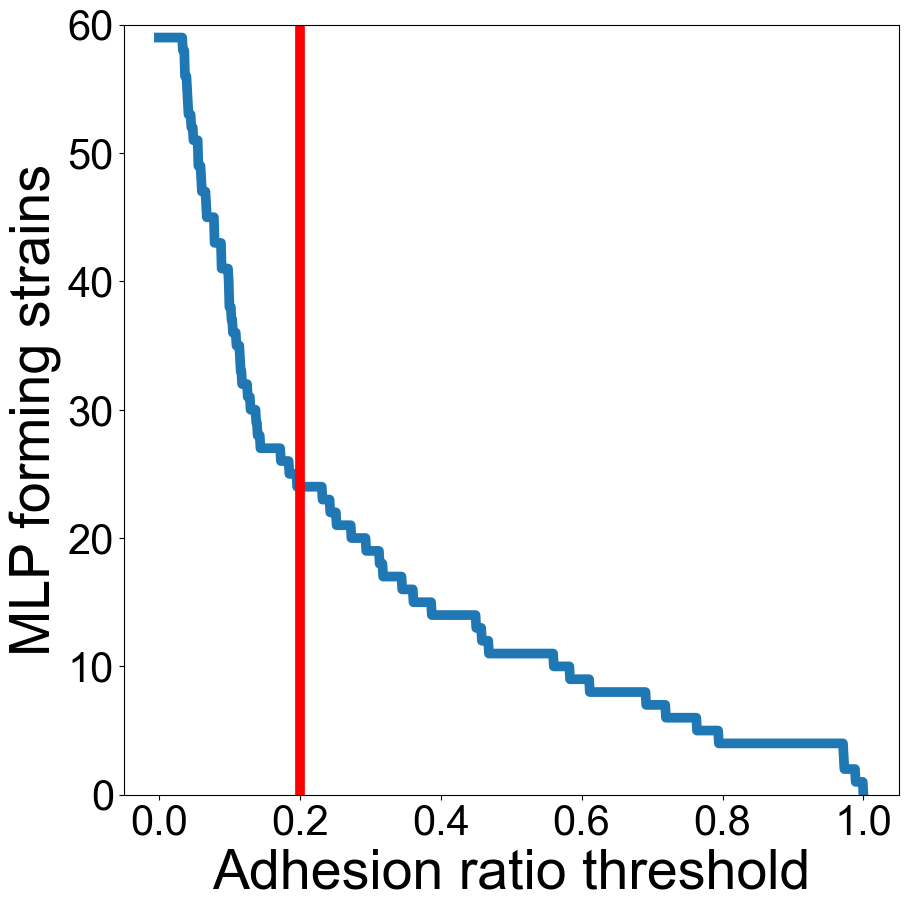

In [18]:
x = np.linspace(0, 1, 1000)

unique_highest_strains = []
for i in x:
    unique_highest_strains.append(len(np.unique(condition_plot_df[condition_plot_df["ratio"]>i]["strain"])))
fig, ax = plt.subplots(figsize=(10, 10))
ax.plot(x,unique_highest_strains,lw=7)
#draw red line at 0.2
ax.plot([0.2,0.2],[0,60],color="red",lw=7)
ax.set_xlabel("Adhesion ratio threshold",fontsize=40)
ax.set_ylabel("MLP forming strains",fontsize=40)
ax.tick_params(axis='both', which='major', labelsize=30)
ax.set_ylim(0,60)
plt.savefig(root + "Figures/All figures/Elbow plot for MLP strains.svg", format="svg", dpi=400)
#as png
plt.savefig(root + "Figures/All figures/Elbow plot for MLP strains.png", format="png", dpi=400)


In [19]:
print(len(highest_strains))
print("The fraction of cells sticking in at least one condition is "+str(len(highest_strains)/len(all_strains)))

24
The fraction of cells sticking in at least one condition is 0.4067796610169492


In [20]:
#print number of cells above threshold in each condition
for i in condition_plot_df["condition"].unique():
    print(i)
    print(len(condition_plot_df[(condition_plot_df["condition"]==i)&(condition_plot_df["ratio"]>0.2)]["strain"].unique()))
    print(len(condition_plot_df[(condition_plot_df["condition"]==i)]["strain"].unique()))
    print(len(condition_plot_df[(condition_plot_df["condition"]==i)&(condition_plot_df["ratio"]>0.2)]["strain"].unique())/len(condition_plot_df[(condition_plot_df["condition"]==i)]["strain"].unique()))
    print("")

YES
 n=6
4
59
0.06779661016949153

YES
 Caffeine
 (10mM) 
 n=10
8
58
0.13793103448275862

YES
 Caffeine
 + Rapa
 n=5
6
51
0.11764705882352941

YES
 Rapa
 (100 ng/ml)
 n=2
3
58
0.05172413793103448

EMM
 n=11
9
59
0.15254237288135594

EMM-P
 n=9
13
59
0.22033898305084745

EMM-N
 n=3
11
58
0.1896551724137931



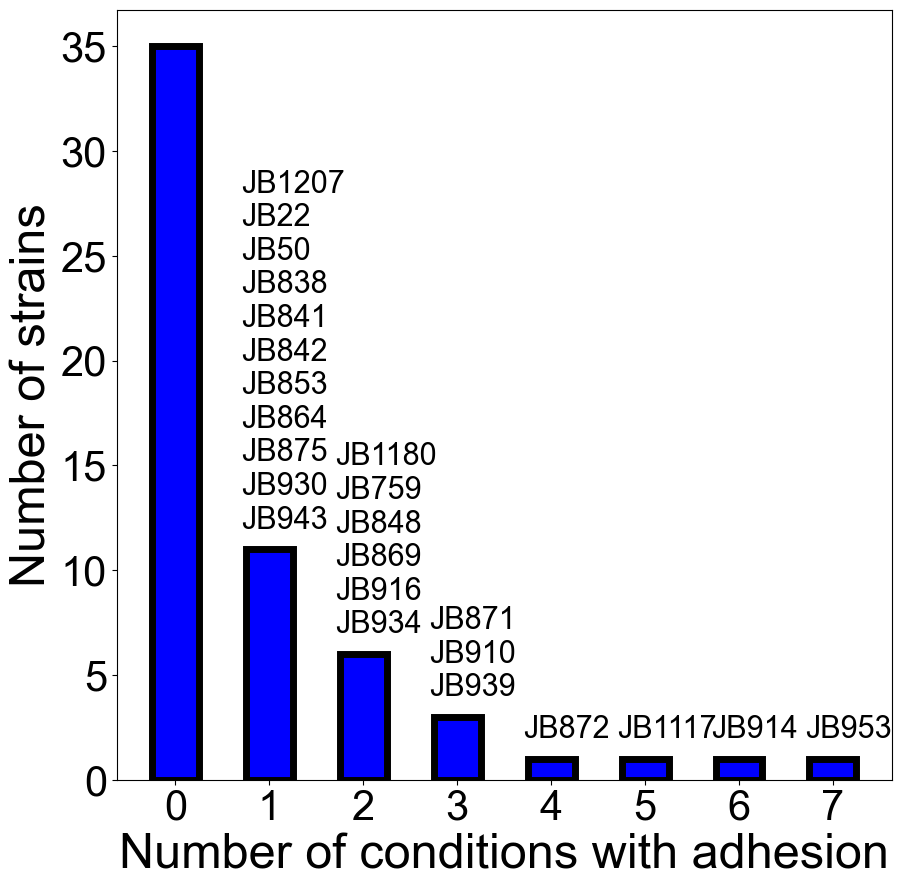

In [21]:
#make histogram of how many conditions each strain is above 0.2
n_of_conds = []
for strain in all_strains:
    n_of_conds.append(len(condition_plot_df[condition_plot_df["strain"]==strain][condition_plot_df["ratio"]>0.2]))
fig, ax = plt.subplots(figsize=(10, 10))
ax.hist(n_of_conds,bins=range(0,9),align="left",rwidth=0.5,color="blue",edgecolor="black",linewidth=5)
#above each bin, except 0, write the names of the strains
for i in range(1,8):
    #find which strains are in this bin
    n_of_conds_index = np.where(np.array(n_of_conds)==i)[0]
    #get the names of these strains
    n_of_conds_strains = np.array(all_strains)[n_of_conds_index]
    #write the names of these strains above the bin, also calculate height of bin
    height_of_given_bin = len(n_of_conds_index==i)
    ax.text(i-0.3,height_of_given_bin+1,"\n".join(n_of_conds_strains),fontsize=22)

ax.set_xlabel("Number of conditions with adhesion",fontsize=35)
ax.set_ylabel("Number of strains",fontsize=35)
ax.set_xticks(range(0,8))
ax.tick_params(axis='both', which='major', labelsize=30)

plt.savefig(root + "Figures/All figures/Number of conditions with adhesion.svg", format="svg", dpi=400)
#as png
plt.savefig(root + "Figures/All figures/Number of conditions with adhesion.png", format="png", dpi=400)
    
    

YES
 n=6 YES
 Caffeine
 (10mM) 
 n=10 -0.7516372459631121 1.3789662103378966
YES
 n=6 YES
 Caffeine
 + Rapa
 n=5 -1.091003471138494 0.8674713252867472
YES
 n=6 YES
 Rapa
 (100 ng/ml)
 n=2 0.1503683544818356 3.3487465125348743
YES
 n=6 EMM
 n=11 -1.4142734602095308 0.4963750362496375
YES
 n=6 EMM-P
 n=9 -2.5028095156124075 0.03677963220367796
YES
 n=6 EMM-N
 n=3 -1.2927278651998062 0.6077939220607794


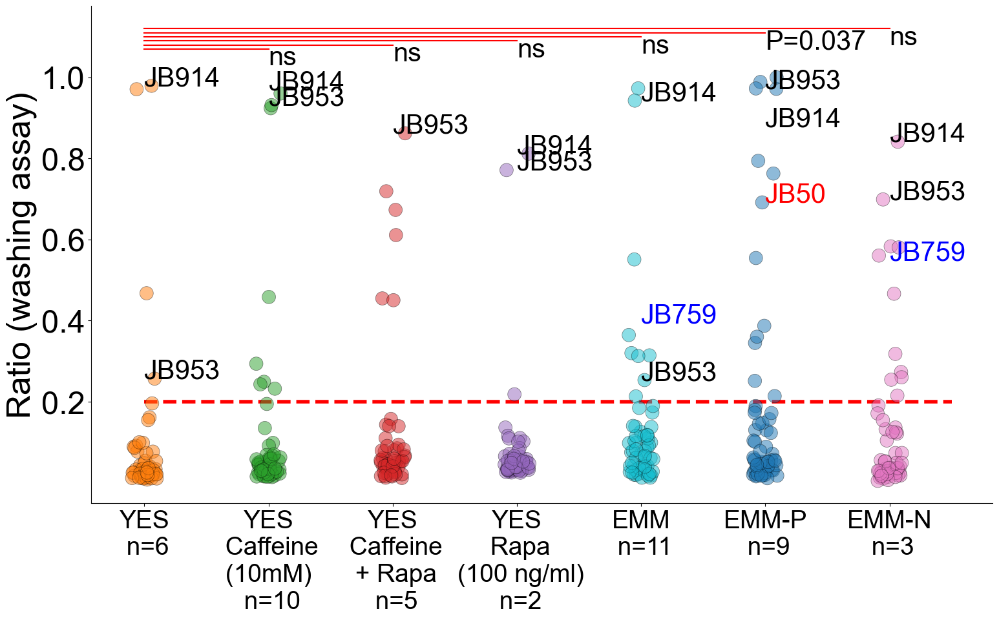

In [22]:
#Make sns boxplot and overlaid stripplot of condition_plot_df with x=condition and y=ratio
conditions=[     "YES\n n=6",
      "YES\n Caffeine\n (10mM) \n n=10",
      "YES\n Caffeine\n + Rapa\n n=5",
      "YES\n Rapa\n (100 ng/ml)\n n=2",
      "EMM\n n=11",
      "EMM-P\n n=9",
      "EMM-N\n n=3"]

interesting_strains = ["JB50","JB759", "JB914", "JB953"]

plt.figure(figsize=(18,10),facecolor="None")
palette = sns.color_palette("tab10", 10)
palette = [palette[1],palette[2],palette[3],palette[4],palette[9],palette[0],palette[6]]

sns.stripplot(x="condition",y="ratio",data=condition_plot_df,jitter=True,size=15,linewidth=0.5,edgecolor="black",alpha=0.5,palette=palette)

plt.ylabel("Ratio of after/before wash intensity")
#draw bars between YES and all other conditions
for i in range(1,len(conditions)):
      #choose strain and ratio
      p1 = condition_plot_df[condition_plot_df["condition"]==conditions[0]]["ratio"].values
      p2 = condition_plot_df[condition_plot_df["condition"]==conditions[i]]["ratio"].values
     
      #mann whitney u test
      s,p = stats.ttest_ind(p1,p2,permutations=100000,alternative="less")
      p=p*(len(conditions)-1)
                            
      
      
      print(conditions[0],conditions[i],s,p)
      
      plt.plot([0,i],[i*0.01+1.06,i*0.01+1.06],color="red")
      if p<0.05:
            plt.text(i,i*0.01+1.02,"P="+str(round(p,3)),fontsize=30)
      if p>0.05:
            plt.text(i,i*0.01+1.02,"ns",fontsize=30)



#to condition_plot_df add two columns, x_vals and y_vals, which correspond to conditions.index(condition_plot_df["condition"][i]) and ratio

condition_plot_df['x_vals'] = condition_plot_df["condition"].apply(lambda x: conditions.index(x))
condition_plot_df['y_vals'] = condition_plot_df["ratio"]


#for y_vals in the same condition and above 0.2, make sure they are all at least 0.05 apart
for i in range(len(condition_plot_df)):
      #if above 0.2
      if condition_plot_df["ratio"][i]>0.2:
            #find whether there is another one close to it
            n_neighbors = len(condition_plot_df[condition_plot_df["x_vals"]==condition_plot_df["x_vals"][i]][abs(condition_plot_df["y_vals"]-condition_plot_df["y_vals"][i])<0.03])
            while n_neighbors>1:
                  #change y_val with a normal distribution 0.05 wide
                  condition_plot_df["y_vals"][i] = condition_plot_df["y_vals"][i] + np.random.normal(0,0.005)
                  #y_val cannot be larger than 1 or smaller than 0.2
                  if condition_plot_df["y_vals"][i]>1:
                        condition_plot_df["y_vals"][i] = 1
                  if condition_plot_df["y_vals"][i]<0.2:
                        condition_plot_df["y_vals"][i] = 0.2
                  n_neighbors = len(condition_plot_df[condition_plot_df["x_vals"]==condition_plot_df["x_vals"][i]][abs(condition_plot_df["y_vals"]-condition_plot_df["y_vals"][i])<0.03])

for i in range(len(condition_plot_df)):
      if condition_plot_df["strain"][i] in interesting_strains and condition_plot_df["ratio"][i]>0.2:
            #if there is same x val and y_val that is within 0.05, then add y_jitter, such that the text is not on top of each other
            #find index where x_vals==condition and y_vals are within 0.05 of condition_plot_df["ratio"][i]
            color = "black"
            if condition_plot_df["strain"][i]=="JB50":
                  color = "red"
            elif condition_plot_df["strain"][i]=="JB759":
                  color = "blue"
            plt.text(condition_plot_df["x_vals"][i],condition_plot_df["y_vals"][i],condition_plot_df["strain"][i],fontsize=30,color=color)
            

#draw a linea t 0.3
plt.plot([0,6.5],[0.2,0.2],color="red",linestyle="--",lw=4)
#larger ticks and labels
plt.xticks(fontsize=28)
plt.yticks(fontsize=35)
plt.xlabel("",fontsize=20)
plt.ylabel("Ratio (washing assay)",fontsize=37)
#onyl label y axis 0.2, 0.4, 0.6, 0.8, 1.0
plt.yticks([0.2,0.4,0.6,0.8,1.0])
#remove background patch
sns.despine()


plt.savefig(root + "Figures/All figures/Compare isolates across conditions.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Compare isolates across conditions.png", format="png", dpi=400)


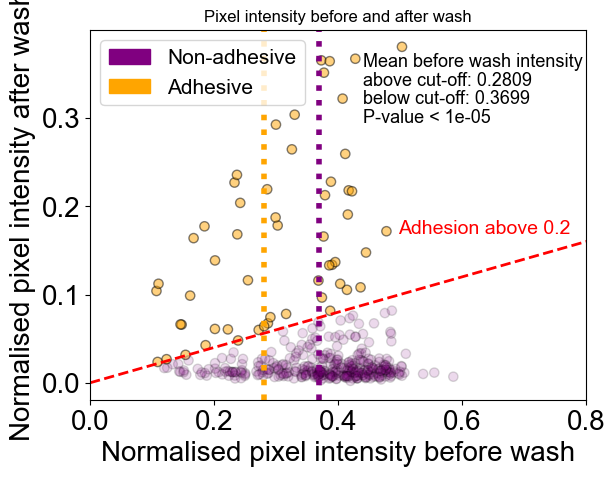

In [23]:
plot_bef_aft = condition_plot_df.copy()
plot_bef_aft["color"]="purple"
plot_bef_aft.loc[plot_bef_aft["after_wash"]>plot_bef_aft["before_wash"]*0.2,"color"]="orange"
#and alpha is normally 0.15, but 0.5 if ratio is above 95th percentile
plot_bef_aft["alpha"]=0.5
#if purple make alpha 0.5
plot_bef_aft.loc[plot_bef_aft["color"]=="purple","alpha"]=0.15
#also draw a line with slope of the ratio of the 95th percentile of ratio valiues
fig, ax = plt.subplots()
#if above the line color purple, otherwise yellow. add legend
ax.scatter(plot_bef_aft["before_wash"],plot_bef_aft["after_wash"], s=45, alpha=plot_bef_aft["alpha"], color=plot_bef_aft["color"], edgecolors="black")


ax.plot([0,1],[0,0.2], color="red", linewidth=2, linestyle="--")
ax.set_xlabel("Normalised pixel intensity before wash", fontsize=20)
ax.set_ylabel("Normalised pixel intensity after wash", fontsize=20)
ax.set_title("Pixel intensity before and after wash")
#print p value of t test of values above and below. that means values above 95th percentile of ratio
above_vals=plot_bef_aft[plot_bef_aft["ratio"]>plot_bef_aft["ratio"].quantile(0.95)]["before_wash"]
below_vals=plot_bef_aft[plot_bef_aft["ratio"]<plot_bef_aft["ratio"].quantile(0.95)]["before_wash"]
#print mean before vals and p value
plt.text(0.55,0.9,"Mean before wash intensity",transform=ax.transAxes, fontsize=13)
plt.text(0.55,0.85,"above cut-off: "+str(round(above_vals.mean(),4)), transform=ax.transAxes, fontsize=13)
plt.text(0.55,0.8,"below cut-off: "+str(round(below_vals.mean(),4)), transform=ax.transAxes, fontsize=13)
plt.text(0.62,0.45,"Adhesion above 0.2", transform=ax.transAxes, color="red",fontsize=14)

#two vertical lines for before and after mean
ax.axvline([above_vals.mean()], color="orange", linestyle="dotted",lw=4)
ax.axvline([below_vals.mean()], color="purple", linestyle="dotted",lw=4)
#xlim 0 0.8
ax.set_xlim(0,0.8)
#larger ticks
ax.tick_params(axis='both', which='major', labelsize=20)
permutations=100000
p_val = stats.ttest_ind(above_vals, below_vals, equal_var=False, permutations=permutations).pvalue
#find how many digits after the decimal point
digits = -int(np.floor(np.log10(p_val+0.0000001)))+5
#round to that many digits

if p_val > 1/p_val:
    p_val = round(p_val, digits)
    plt.text(0.55,0.75,"P-value: "+str(p_val), transform=ax.transAxes, fontsize=13)
else:
    plt.text(0.55,0.75,"P-value < {}".format(1/permutations), transform=ax.transAxes, fontsize=13)

# Create the patches arial
import matplotlib.patches as mpatches
non_adhesive_patch = mpatches.Patch(color='purple', label='Non-adhesive')
adhesive_patch = mpatches.Patch(color='orange', label='Adhesive')

# Create the legend
plt.legend(handles=[non_adhesive_patch, adhesive_patch,],loc="upper left",fontsize=15)




plt.savefig(root + "Figures/All figures/Isolates before after scatter.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Isolates before after scatter.png", format="png", dpi=400)

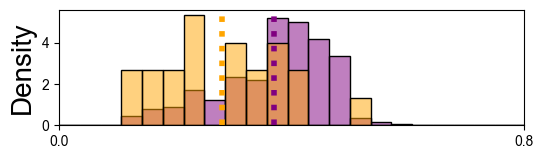

In [24]:

#bin number chosen by freedman diaconis rule
iqr = plot_bef_aft["before_wash"].quantile(0.75) - plot_bef_aft["before_wash"].quantile(0.25)
n_bins = int(1 / (2 * iqr * len(plot_bef_aft["before_wash"]) ** (-1 / 3)))
bins=np.linspace(0,1,n_bins)

fig, ax = plt.subplots(figsize=(6,1.5))
sns.histplot(data=plot_bef_aft[plot_bef_aft["ratio"] < plot_bef_aft["ratio"].quantile(0.95)], x="before_wash", bins=bins, color="purple", alpha=0.5, label="below 95th percentile", ax=ax, kde=False, stat="density")

sns.histplot(data=plot_bef_aft[plot_bef_aft["ratio"] > plot_bef_aft["ratio"].quantile(0.95)], x="before_wash", bins=bins, color="orange", alpha=0.5, label="above 95th percentile", ax=ax, kde=False, stat="density")

#remove x axis ticks
#ticks only 0 and 1
ax.set_xticks([0,0.8])
ax.set_xlabel("")
ax.set_ylabel("Density", fontsize=20)
#xlim 0 0.8
ax.set_xlim(0,0.8)

#two vertical lines for before and after mean
ax.axvline([above_vals.mean()], color="orange", linestyle="dotted",lw=4)
ax.axvline([below_vals.mean()], color="purple", linestyle="dotted",lw=4)
#set all text in the whole ntoebook to be arial
plt.savefig(root + "Figures/All figures/Isolates before after hist.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Isolates before after hist.png", format="png", dpi=400)

<Figure size 3000x1000 with 0 Axes>

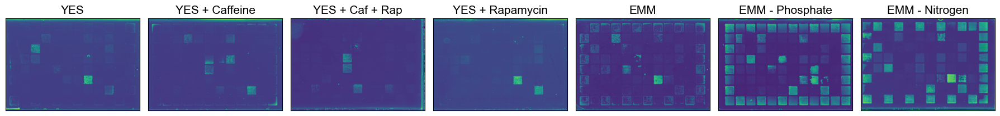

In [25]:
#write a function that takes in the names of folders which contain images of after images, and takes image x from that folder
#and shows it in viridis.

def representative_image(after_folder,ind_image,ax):
    """This function takes in the name of a folder which contains images of after wash images,
     and takes the 'ind_image'th image from that folder.
        It then shows the image in viridis colormap.

    after_folder: name of folder which contains images of after wash images
    ind_image: index of image to show
    """


    #get all images in the folder
    images = os.listdir(after_folder)
        #get the image name of the ind_image'th image
    image_name = images[ind_image]
    #read the image
    image = plt.imread(after_folder + "/" + image_name)
    #show the image in viridis colormap
    #invert the pixel intensity
    image = np.invert(image)
    background = np.percentile(image, 10)
    
    image=image-background
    #rescale by max value
    image=image/np.max(image)
    #crop 40 pixels from each side
    image = image[40:-40,40:-40]


    ax.imshow(image,cmap="viridis")
    

    


plt.figure(figsize=(30,10))

conds = ["YES", "YES + Caffeine", "YES + Caffeine + Rapamycin", "YES + Rapamycin", "EMM",  "EMM - Phosphate","EMM - Nitrogen"]

# create a grid of subplots
fig, axs = plt.subplots(1, 7, figsize=(18, 5))

# loop over the conditions and plot the representative image for each condition
for i, ax in enumerate(axs):
    # get the folder name of the after wash images
    after_folder = root + "Internal data/imaging_adhesion/Wild Isolates_" + conds[i] + "_after/"
    # show the 0th image in that folder
    representative_image(after_folder, 1,ax)
    # set the title as the condition
    #if "YES + Caffeine + Rapamycin", then change to "YES + Caf + Rap"
    ax.set_title(conds[i], fontsize=15)
    if conds[i] == "YES + Caffeine + Rapamycin":
        ax.set_title("YES + Caf + Rap", fontsize=15)
    # remove the ticks
    ax.set_xticks([])
    ax.set_yticks([])
#tight layout
plt.tight_layout()
#save the figure
plt.savefig(root + "Figures/All figures/Representative images.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Representative images.png", format="png", dpi=400)

    

# Plotting segregant data

In [26]:
filtering = pd.read_csv(root + "internal data/Filtering assay/filtering_phenotypes.csv")
#in filtering rename X968 to JB50 and Y0036 to JB759
filtering["Strain"][filtering["Strain"]=="X968"] = "JB50"
filtering["Strain"][filtering["Strain"]=="Y0036"] = "JB759"
#Instead of naming strains R1_xx, name R + filtering["Strain"].str.split("1_").str[1] for only strains that start with R
for i in range(len(filtering)):
      if filtering["Strain"][i][0]=="R":
            filtering["Strain"][i] = "R" + filtering["Strain"][i].split("1_")[1]
        

filtering_grouped=filtering.groupby("Strain",as_index=False).mean()
filtering_grouped["sem"]=filtering.groupby("Strain",as_index=False).sem()["%flocc"]

#merge with phenotype_s strain and Strain in filtering_grouped
filtering_phenotype=filtering_grouped.merge(segregant_emm,left_on="Strain",right_on="strain",how="inner")
filtering_phenotype.head()

,Strain,Unnamed: 0,%flocc,sem_x,strain,ratio,before_wash,after_wash,sem_y,filtered_all_ratio_vals,n
0,JB50,0.0,0.081319,NaN,JB50,0.058670,0.447376,0.026071,0.006489,"[0.07114030578237332, 0.0380942380636818, 0.02...",10
1,JB759,1.0,0.449411,NaN,JB759,0.203279,0.426827,0.082087,0.024199,"[0.25595327742456186, 0.1489746569112507, 0.12...",20
2,R1,2.0,0.104369,NaN,R1,0.049801,0.476540,0.023710,0.003522,"[0.06270775089910191, 0.047641204172752055, 0....",10
3,R10,3.0,0.053252,NaN,R10,0.021799,0.471982,0.010197,0.002406,"[0.033172002643362855, 0.01946389427448803, 0....",10
4,R11,4.0,0.063310,NaN,R11,0.058351,0.268724,0.013188,0.010999,"[0.039417781936507926, 0.044758187263396844, 0...",10


In [27]:

filtering = pd.read_csv(root + "internal data/Filtering assay/filtering_results.csv", sep="\t")
#take median of each strain across Reps but also save sem in a new column
#divide %flocc by 100
filtering["%flocc"]=filtering["%flocc"]/100
filtering_grouped=filtering.groupby("Strain",as_index=False).mean()
filtering_grouped["sem"]=filtering.groupby("Strain",as_index=False).sem()["%flocc"]

#merge with phenotype_s strain and Strain in filtering_grouped
filtering_phenotype=filtering_grouped.merge(segregant_emm,left_on="Strain",right_on="strain",how="inner")
filtering_phenotype.head()

,Strain,ODf,ODr,ODf+ODr,%flocc,Rep,sem_x,strain,ratio,before_wash,after_wash,sem_y,filtered_all_ratio_vals,n
0,JB50,6.600000,0.583333,7.183333,0.081319,2.00,0.004731,JB50,0.058670,0.447376,0.026071,0.006489,"[0.07114030578237332, 0.0380942380636818, 0.02...",10
1,JB759,4.200000,3.400000,7.600000,0.449411,1.75,0.136914,JB759,0.203279,0.426827,0.082087,0.024199,"[0.25595327742456186, 0.1489746569112507, 0.12...",20
2,R1,6.400000,0.733333,7.133333,0.104369,2.00,0.036796,R1,0.049801,0.476540,0.023710,0.003522,"[0.06270775089910191, 0.047641204172752055, 0....",10
3,R10,6.400000,0.366667,6.766667,0.053252,2.00,0.015177,R10,0.021799,0.471982,0.010197,0.002406,"[0.033172002643362855, 0.01946389427448803, 0....",10
4,R11,7.866667,0.546667,8.413333,0.063310,2.00,0.023901,R11,0.058351,0.268724,0.013188,0.010999,"[0.039417781936507926, 0.044758187263396844, 0...",10


In [28]:
filtering_phenotype["color"]=""
for i in range(0,len(filtering_phenotype["Strain"])):
    #if x968 or y0036, then color is red or yellow else blue
      if filtering_phenotype["Strain"][i]=="JB50":
            filtering_phenotype["color"][i]="red"
      elif filtering_phenotype["Strain"][i]=="JB759":
            filtering_phenotype["color"][i]="yellow"
      else:
            filtering_phenotype["color"][i]="blue"
#remove rows with X968 AND Y0036 and put to the end
x968_row=filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]
y0036_row=filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]
filtering_phenotype=filtering_phenotype[filtering_phenotype["Strain"]!="JB50"]
filtering_phenotype=filtering_phenotype[filtering_phenotype["Strain"]!="JB759"]
filtering_phenotype=pd.concat([filtering_phenotype,x968_row])
filtering_phenotype=pd.concat([filtering_phenotype,y0036_row])
filtering_phenotype.reset_index(inplace=True,drop=True)


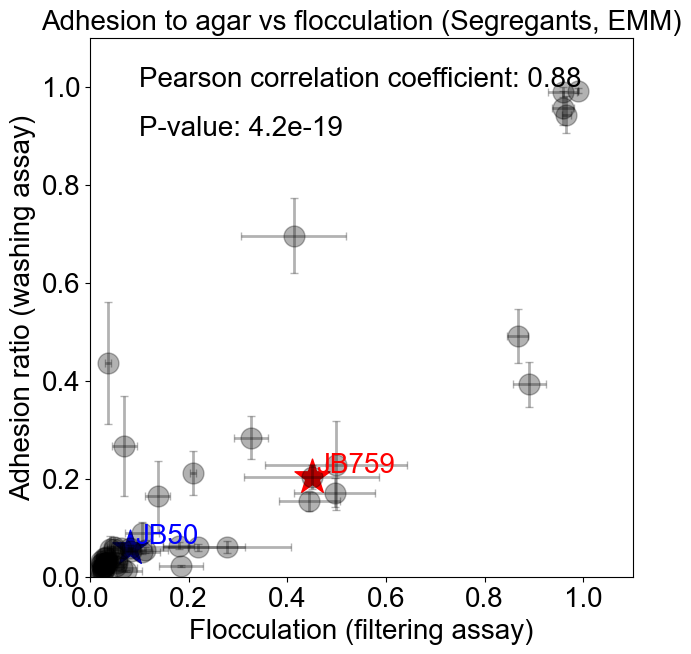

In [52]:
#create scatterplot of filtering vs phenotype and add error bars using sem values from ffiltering_phenotype Show X968 and Y0036 in red and yellow respectively both glyph and text
plt.figure(figsize=(7,7))
#put error bars in back
#Large dots

plt.errorbar(filtering_phenotype["%flocc"],filtering_phenotype["ratio"],xerr=filtering_phenotype["sem_x"],yerr=filtering_phenotype["sem_y"],fmt="o",color="black",alpha=0.3,elinewidth=2,capsize=3,markersize=15)
plt.ylabel("Adhesion ratio (washing assay)",fontsize=20)
plt.xlabel("Flocculation (filtering assay)",fontsize=20)
plt.title("Adhesion to agar vs flocculation (Segregants, EMM)",fontsize=20)
#make it pretty
plt.xlim(0,1.1)
plt.ylim(0,1.1)
#label  X968 and Y0036 filled with red and yellow respectively both glyph and text large dot
plt.text(filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["%flocc"]+0.01,filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["ratio"]+0.01,"JB50",color="blue",fontsize=20)
plt.text(filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["%flocc"]+0.01,filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["ratio"]+0.01,"JB759",color="red",fontsize=20)
#bring these in front of the error bars

plt.scatter(filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["%flocc"],filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["ratio"],color="blue",s=700,marker="*")
plt.scatter(filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["%flocc"],filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["ratio"],color="red",s=700,marker="*")


#ticks to 25
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#print also a spearman correlation coefficient and p value between the two variables
plt.text(0.1,1,"Pearson correlation coefficient: "+str(round(stats.pearsonr(filtering_phenotype["%flocc"],filtering_phenotype["ratio"])[0],2)),fontsize=20)
plt.text(0.1,0.9,"P-value: "+str(round(stats.pearsonr(filtering_phenotype["%flocc"],filtering_phenotype["ratio"])[1],20)),fontsize=20)


plt.savefig(root + "Figures/All figures/segregants adhesion flocculation corr.svg", format="svg",dpi=400)
plt.savefig(root + "Figures/All figures/segregants adhesion flocculation corr.png", format="png",dpi=400)



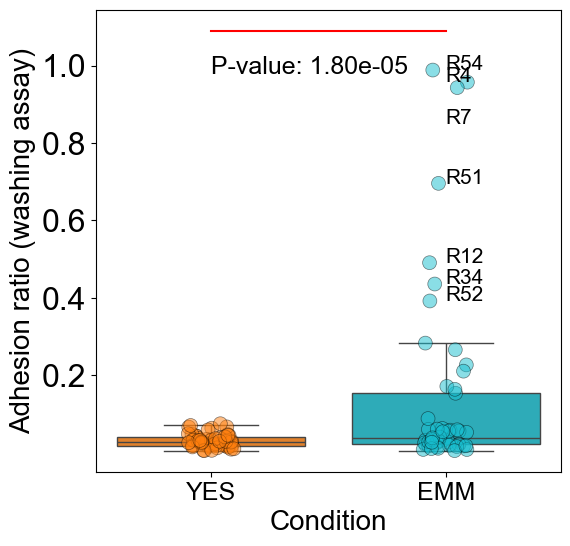

In [31]:

condition_plot_df = pd.concat([segregant_yes, segregant_emm])

condition_plot_df = condition_plot_df.reset_index(drop=True)
conditions = np.array([["YES"] * len(segregant_yes)])[0]

conditions = np.append(conditions, [["EMM"] * len(segregant_emm)])


condition_plot_df["condition"] = conditions
condition_plot_df["y_vals"] = condition_plot_df["ratio"]
#remove strains that start with JB and then reset index
condition_plot_df = condition_plot_df[~condition_plot_df["strain"].str.startswith("JB")]
#remove R45 and R48
condition_plot_df = condition_plot_df[~condition_plot_df["strain"].str.startswith("R45")]

condition_plot_df = condition_plot_df.reset_index(drop=True)

highest_strains = np.unique(condition_plot_df[condition_plot_df["ratio"]>0.3]["strain"])
subset_df = condition_plot_df[condition_plot_df["strain"].isin(highest_strains)]

#Make sns boxplot and overlaid stripplot of condition_plot_df with x=condition and y=ratio
conditions=[     "YES",
     "EMM"]
palette = sns.color_palette("tab10")
palette = [palette[1],palette[9]]
plt.figure(figsize=(6,6))
sns.boxplot(x="condition",y="ratio",data=condition_plot_df,showfliers=False,palette=palette)
#paltte is second and tenth color of tab10 palette

sns.stripplot(x="condition",y="ratio",data=condition_plot_df,jitter=True,size=10,linewidth=0.5,edgecolor="black",alpha=0.5,palette=palette)
plt.ylabel("Ratio of after/before wash intensity")
#draw bars between YES and all other conditions
for i in range(1,len(conditions)):
      #choose strain and ratio
      p1 = condition_plot_df[condition_plot_df["condition"]==conditions[0]][["strain","ratio"]]
      p2 = condition_plot_df[condition_plot_df["condition"]==conditions[i]][["strain","ratio"]]
      #create p3 by merging over strai
      p3 = pd.merge(p1,p2,on="strain")
      p3["diff"] = p3["ratio_x"]-p3["ratio_y"]
      #do t test
      s,p = stats.ttest_ind(p3["ratio_x"],p3["ratio_y"],permutations=1000000)
      
      if p<0.05:
            plt.plot([0,i],[i*0.03+1.06,i*0.03+1.06],color="red")
            #print p in scientific notation
            plt.text(0,0.98,"P-value: {:.2e}".format(p),fontsize=18)
      if p>0.05:
            plt.text(0,i*0.03+1.05,"ns",fontsize=20)

#print the strain name for those with ratio>0.5
x_vals=[]
y_vals=[]

for i in range(len(condition_plot_df)):
      if condition_plot_df["ratio"][i]>0.3:
            #convert condition value to number
            condition = conditions.index(condition_plot_df["condition"][i])
            indices = [j for j, x in enumerate(x_vals) if x == condition and abs(y_vals[j]-condition_plot_df["y_vals"][i])<0.06]
            y_jitter=0
            while len(indices)>1:
                  
                  #move the larger index higher
                  
                  y_val_index_0 = y_vals[indices[0]]
                  if y_val_index_0>condition_plot_df["y_vals"][i]:
                        y_jitter = stats.norm.rvs(loc=0.02,scale=0.01)
                  else:
                        y_jitter = stats.norm.rvs(loc=-0.02,scale=0.01)
                  condition_plot_df["y_vals"][i] = condition_plot_df["y_vals"][i]+y_jitter
                  indices = [j for j, x in enumerate(x_vals) if x == condition and abs(y_vals[j]-condition_plot_df["y_vals"][i])<0.06]
            
            
            x_vals.append(condition)
            y_vals.append(condition_plot_df["y_vals"][i])
          

            plt.text(condition,condition_plot_df["y_vals"][i]+y_jitter,condition_plot_df["strain"][i],fontsize=15)

#larger ticks and labels
plt.xticks(fontsize=18)
plt.yticks(fontsize=23)
plt.xlabel("Condition",fontsize=20)
plt.ylabel("Adhesion ratio (washing assay)",fontsize=20)
#only label y axis 0.2, 0.4, 0.6, 0.8, 1.0
plt.yticks([0.2,0.4,0.6,0.8,1.0])

plt.savefig(root + "Figures/All figures/segregants emm_yes.svg", format="svg",dpi=400)
plt.savefig(root + "Figures/All figures/segregants emm_yes.png", format="png",dpi=400)

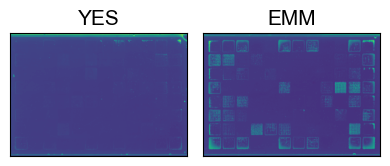

In [32]:

conds = ["YES", "EMM"]
# create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(4, 5))

# loop over the conditions and plot the representative image for each condition
for i, ax in enumerate(axs):
    # get the folder name of the after wash images
    after_folder = root + "Internal data/imaging_adhesion/Segregants_" + conds[i] + "_after/"
    # show the 0th image in that folder
    representative_image(after_folder, 1,ax)
    # set the title as the condition
    #if "YES + Caffeine + Rapamycin", then change to "YES + Caf + Rap"
    ax.set_title(conds[i], fontsize=15)
    
    # remove the ticks
    ax.set_xticks([])
    ax.set_yticks([])
#tight layout
plt.tight_layout()
#save the figure
plt.savefig(root + "Figures/All figures/Representative images segregants.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Representative images segregants.png", format="png", dpi=400)

# Plot on the wild isolates adhesion vs flocculation m



In [33]:
# Plot for wild isolates adhesion vs flocculation
wild_isolates_floc = pd.read_csv(root + "Bence folder/Plate_reader_assay/plate_reader_wild_isolates_results.csv",delimiter=",")

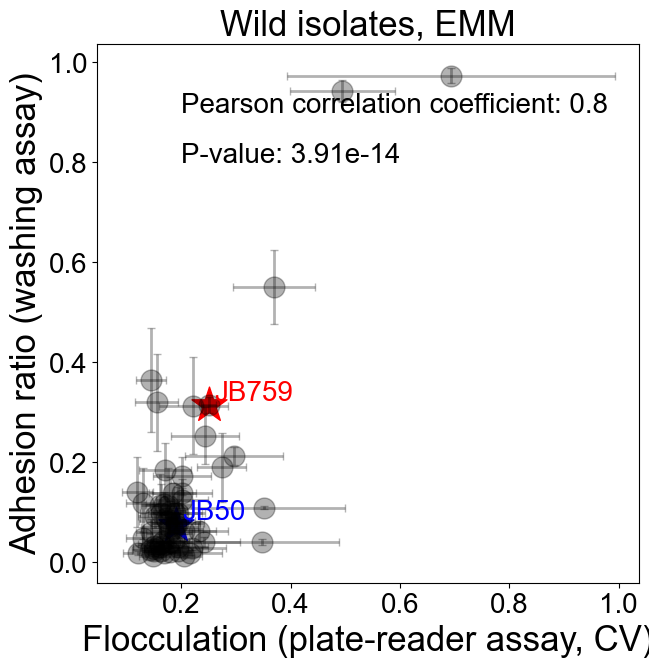

In [61]:
#wild_isolates_floc merge with phenotype_gwas
wild_isolates_floc_phenotype=wild_isolates_floc.merge(wild_isolate_emm,left_on="Strain",right_on="strain",how="inner")
#create scatterplot of filtering vs phenotype and add error bars using sem values from ffiltering_phenotype 
plt.figure(figsize=(7,7))
plt.errorbar(wild_isolates_floc_phenotype["CV"],wild_isolates_floc_phenotype["ratio"],xerr=wild_isolates_floc_phenotype["sem_x"],yerr=wild_isolates_floc_phenotype["sem_y"],fmt="o", color="black",alpha=0.3,elinewidth=2,capsize=3,markersize=15)
plt.ylabel("Adhesion ratio (washing assay)",fontsize=25)
plt.xlabel("Flocculation (plate-reader assay, CV)",fontsize=25)
plt.title("Wild isolates, EMM",fontsize=25)
#larger ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#highlight JB50 and JB759
plt.scatter(wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB50"]["CV"],wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB50"]["ratio"],color="blue",s=700,marker="*")
plt.scatter(wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB759"]["CV"],wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB759"]["ratio"],color="red",s=700,marker="*")
#write JB50 and JB759
plt.text(wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB50"]["CV"]+0.01,wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB50"]["ratio"]+0.01,"JB50",color="blue",fontsize=20)
plt.text(wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB759"]["CV"]+0.01,wild_isolates_floc_phenotype[wild_isolates_floc_phenotype["Strain"]=="JB759"]["ratio"]+0.01,"JB759",color="red",fontsize=20)


#test spearman correlation coefficient and p value between the two variables
plt.text(0.2,0.9,"Pearson correlation coefficient: "+str(round(stats.pearsonr(wild_isolates_floc_phenotype["CV"],wild_isolates_floc_phenotype["ratio"])[0],2)),fontsize=20)
#also print p value
plt.text(0.2,0.8,"P-value: {:.2e}".format(stats.pearsonr(wild_isolates_floc_phenotype["CV"],wild_isolates_floc_phenotype["ratio"])[1]),fontsize=20)
plt.savefig(root + "Figures/All figures/wild isolates adhesion flocc corr.svg", format="svg",dpi=400)
plt.savefig(root + "Figures/All figures/wild isolates adhesion flocc corr.png", format="png",dpi=400)



In [35]:
# Plot of EMM vs YES for wild isolates
#phenotype_gwas merge with phenotype_yes
wi_emm_yes=wild_isolate_emm.merge(wild_isolate_yes,left_on="strain",right_on="strain",how="inner")
#remove entry with strain EMPTY
wi_emm_yes=wi_emm_yes[wi_emm_yes["strain"]!="EMPTY"]
#put values of ratio_x and ratio_y into one shared column and create a second that is called media with entries EMM and YES
ratio=np.concatenate((wi_emm_yes["ratio_x"],wi_emm_yes["ratio_y"]))
media = ["EMM"]*len(wi_emm_yes["ratio_x"])+["YES"]*len(wi_emm_yes["ratio_y"])
strains = np.concatenate((wi_emm_yes["strain"],wi_emm_yes["strain"]))
plot_df = pd.DataFrame({"ratio":ratio,"media":media,"strain":strains})

import iqplot 
import bokeh.io
bokeh.io.show(iqplot.strip(plot_df, q="ratio", cats="media", parcoord_column="strain", q_axis="y", title="EMM vs YES for wild isolates"))
#do a paired t-test between EMM and YES for wild isolates
stats.ttest_rel(wi_emm_yes["ratio_x"],wi_emm_yes["ratio_y"])


TtestResult(statistic=3.001555872377544, pvalue=0.003956770939100878, df=58)

# Plotting segregant adhesion results when splitting by the most significant SNP

In [36]:
#Plotting the results when splitting at the most significant SNP
#read in snp data /Users/bencekover/Library/CloudStorage/OneDrive-UniversityCollegeLondon/MSci Bahler lab/S.-Pombe-biofilm/internal data/updated_genotype_matrix_final_pos.tsv
snps = pd.read_csv(root + "internal data/updated_genotype_matrix_final_pos.tsv",delimiter="\t")

seg_plot_df = filtering_phenotype.copy()
#remove R45 and R48
seg_plot_df = seg_plot_df[seg_plot_df["Strain"]!="R45"]
seg_plot_df = seg_plot_df[seg_plot_df["Strain"]!="R48"]

#rename strains JB50 to X968 and JB759 to Y0036
seg_plot_df["Strain"] = seg_plot_df["Strain"].replace("JB50","X968")
seg_plot_df["Strain"] = seg_plot_df["Strain"].replace("JB759","Y0036")

import re

# loop through each row in the DataFrame
for i, row in seg_plot_df.iterrows():
    # check if the strain name starts with "R" followed by a number
    if re.match(r"^R\d+$", row["Strain"]):
        # rename the strain by replacing "R" with "R1_"
        seg_plot_df.at[i, "Strain"] = "R1_" + row["Strain"][1:]

#reset index
seg_plot_df = seg_plot_df.reset_index(drop=True)


In [37]:
#in snps rename column 968 to X968
snps.rename(columns={"968":"X968"},inplace=True)
#keep only rows  2341 and 2431 in snps
snps=snps.iloc[[2341,2431,3540],:]
#reset
snps.reset_index(inplace=True,drop=True)
srb_geno = []
ncrna_geno = []
hsp_geno = []


#itearte through seg_plot_df
for i in range(len(seg_plot_df)):
      strain=seg_plot_df.iloc[i]["Strain"]
      #if strain is in snps colnames
      if strain in snps.columns:
            srb_geno.append(snps[strain][0])
            ncrna_geno.append(snps[strain][1])
            hsp_geno.append(snps[strain][2])

      else:
            srb_geno.append(np.nan)
            ncrna_geno.append(np.nan)
            hsp_geno.append(np.nan)
seg_plot_df["srb_geno"]=srb_geno
seg_plot_df["ncrna_geno"]=ncrna_geno
seg_plot_df["hsp_geno"]=hsp_geno
seg_plot_df["srb_geno_jitter"]=seg_plot_df["srb_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
seg_plot_df["ncrna_geno_jitter"]=seg_plot_df["ncrna_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
seg_plot_df["hsp_geno_jitter"]=seg_plot_df["hsp_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
#newly sequenced if in R1_34, R1_44, R1_48, R1_49,R1_50, R1_51, R1_52, R1_53 and R1_54
seg_plot_df["newly_sequenced"]=seg_plot_df["Strain"].isin(["R1_34", "R1_44", "R1_48", "R1_49","R1_50", "R1_51", "R1_52", "R1_53", "R1_54"])

#reset index
seg_plot_df.reset_index(inplace=True,drop=True)



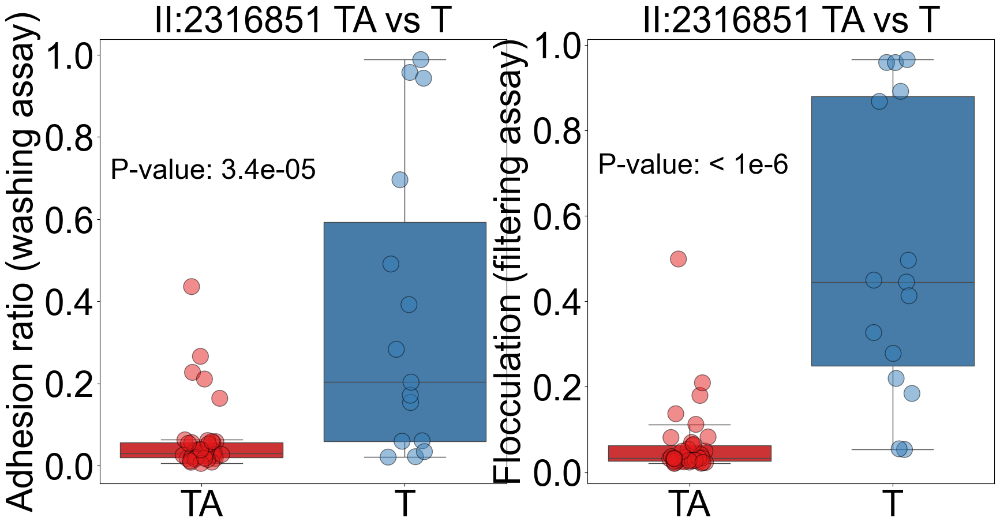

In [38]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

# plot the first plot
sns.boxplot(x="srb_geno", y="ratio", data=seg_plot_df, ax=ax[0], showfliers=False, palette="Set1")
sns.stripplot(x="srb_geno", y="ratio", data=seg_plot_df, ax=ax[0], s=20, alpha=0.5, palette="Set1",edgecolor="black",linewidth=1)

ax[0].set_title("II:2316851 TA vs T", fontsize=45)
ax[0].set_xlabel("", fontsize=30)
ax[0].set_xticklabels(["TA", "T"], fontsize=45)
ax[0].set_ylabel("Adhesion ratio (washing assay)", fontsize=45)
ax[0].tick_params(axis='y', labelsize=45)
ax[0].text(-0.45, 0.7, "P-value: " + str(round(stats.ttest_ind(seg_plot_df[seg_plot_df["srb_geno"] == 0]["ratio"], seg_plot_df[seg_plot_df["srb_geno"] == 1]["ratio"], permutations=1000000)[1], 10)), fontsize=35)

# plot the second plot
sns.boxplot(x="srb_geno", y="%flocc", data=seg_plot_df, ax=ax[1], showfliers=False, palette="Set1")
sns.stripplot(x="srb_geno", y="%flocc", data=seg_plot_df, ax=ax[1], s=20, alpha=0.5, palette="Set1",edgecolor="black",linewidth=1)

ax[1].set_title("II:2316851 TA vs T", fontsize=45)
ax[1].set_xlabel("", fontsize=30)
ax[1].set_xticklabels(["TA", "T"], fontsize=45)
ax[1].set_ylabel("Flocculation (filtering assay)", fontsize=45)
ax[1].tick_params(axis='y', labelsize=45)
#if p value less than what can be determined using the permutation test, say that it is less than 1e-6
p_val = stats.ttest_ind(seg_plot_df[seg_plot_df["srb_geno"] == 0]["%flocc"], seg_plot_df[seg_plot_df["srb_geno"] == 1]["%flocc"], permutations=1000000)[1]
if p_val < 1e-6:
    ax[1].text(-0.45, 0.7, "P-value: < 1e-6", fontsize=35)
else:
    ax[1].text(-0.45, 0.7, "P-value: " + str(round(p_val, 10)), fontsize=35)


plt.savefig(root + "Figures/All figures/segregants adhesion flocc snp.svg", format="svg", dpi=400, bbox_inches="tight")
plt.savefig(root + "Figures/All figures/segregants adhesion flocc snp.png", format="png", dpi=400, bbox_inches="tight")

In [39]:
%load_ext watermark
%watermark


Last updated: 2023-12-10T12:48:35.341008+00:00

Python implementation: CPython
Python version       : 3.11.5
IPython version      : 8.16.1

Compiler    : Clang 13.0.0 (clang-1300.0.29.30)
OS          : Darwin
Release     : 22.6.0
Machine     : arm64
Processor   : arm
CPU cores   : 10
Architecture: 64bit



In [40]:
%watermark --iversions



matplotlib: 3.8.0
sys       : 3.11.5 (v3.11.5:cce6ba91b3, Aug 24 2023, 10:50:31) [Clang 13.0.0 (clang-1300.0.29.30)]
iqplot    : 0.3.5
scipy     : 1.11.3
skimage   : 0.20.0
bokeh     : 3.3.2
pandas    : 1.4.4
re        : 2.2.1
yeastmlp  : 1.0.3
seaborn   : 0.13.0
numpy     : 1.23.4

